In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import torch
print(torch.__version__)

2.6.0+cu124


In [ ]:
# # Step 1: Uninstall existing version
# !pip uninstall -y open_clip_torch

# Install latest OpenCLIP from GitHub
!pip install git+https://github.com/mlfoundations/open_clip.git

  Cloning https://github.com/mlfoundations/open_clip.git to /tmp/pip-req-build-e_z_d87t
  Running command git clone --filter=blob:none --quiet https://github.com/mlfoundations/open_clip.git /tmp/pip-req-build-e_z_d87t
  Resolved https://github.com/mlfoundations/open_clip.git to commit bf5d49c112c82c738f7b34bde6e154760a711790
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 109.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 83.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 59.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 4

In [ ]:
# !pip install imageio
# !pip install mpi4py

In [ ]:
# !pip install opencv-python

In [ ]:
# !pip install lpips

### 0. Load Normalized MUA + Image Dataset

In [ ]:
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader, TensorDataset
from torchvision import transforms
import h5py
from sklearn.model_selection import KFold
from transformers import CLIPVisionModel, CLIPProcessor, CLIPModel
from transformers import BlipProcessor, BlipForConditionalGeneration
from PIL import Image
# from diffusers import StableDiffusionImg2ImgPipeline, AutoencoderKL
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
from scipy.stats import pearsonr, ttest_rel, wilcoxon
# import lpips
from tqdm import tqdm
import cv2
import gc
import random
import torchvision.utils as vutils

import plotly.graph_objects as go
import base64
from io import BytesIO
import joblib
import traceback
from scipy.spatial.distance import cosine as cosine_distance
from sklearn.linear_model import Ridge
from sklearn.metrics import mean_squared_error

import open_clip
import glob

from skimage.metrics import structural_similarity as ssim
from skimage.color import rgb2gray
from torchvision.models import alexnet, inception_v3, efficientnet_b1
from torchvision.models.feature_extraction import create_feature_extractor
import scipy.spatial
import seaborn as sns
from scipy.stats import sem, t
from torchvision.utils import save_image

# import sys
# sys.path.append('/content/drive/MyDrive/TVSD_Materials/brain-diffuser/vdvae')
# from hps import Hyperparams
# from vae import VAE

%cd /content/drive/MyDrive/TVSD_Materials/brain-diffuser/vdvae
import hps
from vae import VAE
from types import SimpleNamespace

/content/drive/.shortcut-targets-by-id/1pu2z08XCHHoOBNnZQoV5BbP0PlvFf4Pk/TVSD_Materials/brain-diffuser/vdvae


In [ ]:
# ✅ Set a global seed for reproducibility
SEED = 42
np.random.seed(SEED)
random.seed(SEED)
torch.manual_seed(SEED)  # If using PyTorch models

# ✅ Ensure deterministic behavior in some libraries
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

In [ ]:
# ✅ Define dataset paths for both monkeys
monkeyF_data_path = "/content/drive/My Drive/TVSD_Materials/data/monkeyF_THINGS_normMUA_no mapping.mat"
monkeyN_data_path = "/content/drive/My Drive/TVSD_Materials/data/monkeyN_THINGS_normMUA_no mapping.mat"

# ✅ Image Mapping and Image Folder Paths (unchanged)
image_mapping_path = "/content/drive/My Drive/TVSD_Materials/data/things_imgs.mat"
image_base_path = "/content/drive/My Drive/TVSD_Materials/data/object_images"

In [ ]:
# ✅ Load Monkey F and Monkey N MUA Data using h5py
with h5py.File(monkeyF_data_path, 'r') as f:
    train_MUA_F = np.array(f["train_MUA"])  # Shape: (22248, 1024)
    test_MUA_F = np.array(f["test_MUA"])  # Shape: (100, 1024)

with h5py.File(monkeyN_data_path, 'r') as f:
    train_MUA_N = np.array(f["train_MUA"])
    test_MUA_N = np.array(f["test_MUA"])

print(f"✅ Monkey F - Train MUA Shape: {train_MUA_F.shape}, Test MUA Shape: {test_MUA_F.shape}")
print(f"✅ Monkey N - Train MUA Shape: {train_MUA_N.shape}, Test MUA Shape: {test_MUA_N.shape}")

✅ Monkey F - Train MUA Shape: (22248, 1024), Test MUA Shape: (100, 1024)
✅ Monkey N - Train MUA Shape: (22248, 1024), Test MUA Shape: (100, 1024)


In [ ]:
# Open the HDF5 file and inspect the structure
with h5py.File(image_mapping_path, "r") as file:
    train_things_path = file["train_imgs"]["things_path"]
    test_things_path = file["test_imgs"]["things_path"]

    print("🔹 Type of 'things_path' for train set:", type(train_things_path))
    print("🔹 Shape of 'things_path' for train set:", train_things_path.shape)

    # Print raw entries to understand the structure
    print("\n🔹 First 5 raw training entries in 'things_path':", train_things_path[:5])
    print("\n🔹 First 5 raw test entries in 'things_path':", test_things_path[:5])

🔹 Type of 'things_path' for train set: <class 'h5py._hl.dataset.Dataset'>
🔹 Shape of 'things_path' for train set: (22248, 1)

🔹 First 5 raw training entries in 'things_path': [[<HDF5 object reference>]
 [<HDF5 object reference>]
 [<HDF5 object reference>]
 [<HDF5 object reference>]
 [<HDF5 object reference>]]

🔹 First 5 raw test entries in 'things_path': [[<HDF5 object reference>]
 [<HDF5 object reference>]
 [<HDF5 object reference>]
 [<HDF5 object reference>]
 [<HDF5 object reference>]]


In [ ]:
def extract_filenames_from_hdf5(file, dataset_path):
    """
    Correctly extracts filenames stored in an HDF5 dataset.
    Fixes encoding issues and converts Windows paths to Unix-style paths.
    """
    dataset = file[dataset_path]
    filenames = []

    for ref in dataset[:, 0]:  # Iterate over all references in the first column
        try:
            ref_obj = file[ref]
            if isinstance(ref_obj, h5py.Dataset):
                # Decode from UTF-16, remove null bytes, and replace backslashes
                filename = bytes(ref_obj[()]).decode('utf-16').strip().replace('\\', '/')
                filenames.append(filename)
            else:
                filenames.append("Invalid_Reference")
        except Exception as e:
            print(f"Decoding error: {e}")
            filenames.append("Error")

    return filenames

# Inspect HDF5 file structure
def print_hdf5_structure(name, obj):
    print(f"Object Path: {name}, Type: {type(obj)}")

print("📂 HDF5 File Structure:")
with h5py.File(image_mapping_path, 'r') as f:
    f.visititems(print_hdf5_structure)

# Extract filenames and normalize paths
with h5py.File(image_mapping_path, 'r') as file:
    train_image_filenames = extract_filenames_from_hdf5(file, "train_imgs/things_path")
    test_image_filenames = extract_filenames_from_hdf5(file, "test_imgs/things_path")

print("\n✅ First 5 training set filenames:", train_image_filenames[:5])
print("✅ First 5 test set filenames:", test_image_filenames[:5])

Streaming output truncated to the last 5000 lines.
Object Path: #refs#/vOh, Type: <class 'h5py._hl.dataset.Dataset'>
Object Path: #refs#/vOi, Type: <class 'h5py._hl.dataset.Dataset'>
Object Path: #refs#/vOj, Type: <class 'h5py._hl.dataset.Dataset'>
Object Path: #refs#/vOk, Type: <class 'h5py._hl.dataset.Dataset'>
Object Path: #refs#/vOl, Type: <class 'h5py._hl.dataset.Dataset'>
Object Path: #refs#/vOm, Type: <class 'h5py._hl.dataset.Dataset'>
Object Path: #refs#/vOn, Type: <class 'h5py._hl.dataset.Dataset'>
Object Path: #refs#/vOo, Type: <class 'h5py._hl.dataset.Dataset'>
Object Path: #refs#/vOp, Type: <class 'h5py._hl.dataset.Dataset'>
Object Path: #refs#/vOq, Type: <class 'h5py._hl.dataset.Dataset'>
Object Path: #refs#/vP, Type: <class 'h5py._hl.dataset.Dataset'>
Object Path: #refs#/vPb, Type: <class 'h5py._hl.dataset.Dataset'>
Object Path: #refs#/vPc, Type: <class 'h5py._hl.dataset.Dataset'>
Object Path: #refs#/vPd, Type: <class 'h5py._hl.dataset.Dataset'>
Object Path: #refs#/vPe, T

In [ ]:
# Open the file
with h5py.File(image_mapping_path, "r") as file:
    train_things_path = file["train_imgs"]["things_path"]
    test_things_path = file["test_imgs"]["things_path"]

    print("🔹 Type of 'things_path' for train set:", type(train_things_path))
    print("🔹 Shape of 'things_path' for train set:", train_things_path.shape)
    print("🔹 Sample entry type:", type(train_things_path[0]))

    # Print the first five entries to see the raw values
    print("\n🔹 First 5 entries in 'things_path':", train_things_path[:5])

🔹 Type of 'things_path' for train set: <class 'h5py._hl.dataset.Dataset'>
🔹 Shape of 'things_path' for train set: (22248, 1)
🔹 Sample entry type: <class 'numpy.ndarray'>

🔹 First 5 entries in 'things_path': [[<HDF5 object reference>]
 [<HDF5 object reference>]
 [<HDF5 object reference>]
 [<HDF5 object reference>]
 [<HDF5 object reference>]]


In [ ]:
# def extract_filenames_from_hdf5(file, dataset_path):
#     """
#     Correctly extracts filenames stored in an HDF5 dataset.
#     Fixes encoding issues and converts Windows paths to Unix-style paths.
#     """
#     dataset = file[dataset_path]
#     filenames = []

#     for ref in dataset[:, 0]:  # Iterate over all references in the first column
#         try:
#             ref_obj = file[ref]
#             if isinstance(ref_obj, h5py.Dataset):
#                 # Decode from UTF-16, remove null bytes, and replace backslashes
#                 filename = bytes(ref_obj[()]).decode('utf-16').strip().replace('\\', '/')
#                 filenames.append(filename)
#             else:
#                 filenames.append("Invalid_Reference")
#         except Exception as e:
#             print(f"Decoding error: {e}")
#             filenames.append("Error")

#     return filenames

# # Inspect HDF5 file structure
# def print_hdf5_structure(name, obj):
#     print(f"Object Path: {name}, Type: {type(obj)}")

# print("📂 HDF5 File Structure:")
# with h5py.File(image_mapping_path, 'r') as f:
#     f.visititems(print_hdf5_structure)

# # Extract filenames and normalize paths
# with h5py.File(image_mapping_path, 'r') as file:
#     train_image_filenames = extract_filenames_from_hdf5(file, "train_imgs/things_path")
#     test_image_filenames = extract_filenames_from_hdf5(file, "test_imgs/things_path")

# print("\n✅ First 5 training set filenames:", train_image_filenames[:5])
# print("✅ First 5 test set filenames:", test_image_filenames[:5])

In [ ]:
# ✅ Generate full paths for training and test images
# train_image_paths = [os.path.join(image_base_path, filename) for filename in train_image_filenames]
# test_image_paths = [os.path.join(image_base_path, filename) for filename in test_image_filenames]

# # ✅ Check if the image files exist
# missing_train = [path for path in train_image_paths if not os.path.exists(path)]
# missing_test = [path for path in test_image_paths if not os.path.exists(path)]

# # ✅ Print verification results
# print(f"✅ Total Training Images: {len(train_image_paths)}, Missing: {len(missing_train)}")
# print(f"✅ Total Test Images: {len(test_image_paths)}, Missing: {len(missing_test)}")

In [ ]:
# import os

# # ✅ Generate full paths for training and test images
train_image_paths = [os.path.join(image_base_path, filename) for filename in train_image_filenames]
test_image_paths = [os.path.join(image_base_path, filename) for filename in test_image_filenames]

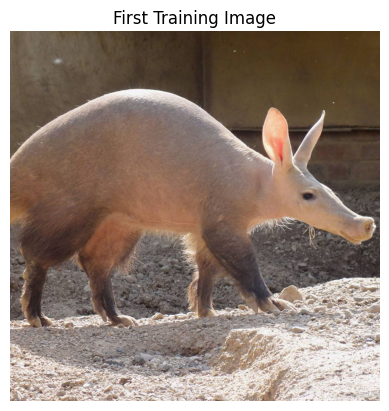

In [ ]:
image_path = train_image_paths[0]

if os.path.exists(image_path):
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert OpenCV BGR format to RGB
    plt.imshow(img)
    plt.title("First Training Image")
    plt.axis("off")
    plt.show()
else:
    print(f"❌ Image not found: {image_path}")

### 1. Extract CLIP Features for Decoding

#### 1.1 Extract CLIP Vision MLP Features

Extract **257 tokens (CLS + 256 patch embeddings)** from the **CLIP ViT-L/14** model.

In [ ]:
# Load model + transform
clip_model, _, preprocess = open_clip.create_model_and_transforms(
    'ViT-L-14', pretrained='openai'
)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
clip_model = clip_model.to(device).eval()

# Ensure output tokens are returned (for patch-level features)
clip_model.visual.output_tokens = True

def extract_full_features(image_filenames, image_base_path, set_type):
    save_dir = "/content/drive/My Drive/TVSD_Materials/saved/clip/features/"
    save_path = os.path.join(save_dir, f"{set_type}_clip_features.npy")
    os.makedirs(save_dir, exist_ok=True)

    if os.path.exists(save_path):
        print(f"✅ {set_type} features already extracted!")
        return

    all_features = []

    for img_filename in tqdm(image_filenames, desc=f"Extracting {set_type} features"):
        img_path = os.path.join(image_base_path, img_filename)
        if not os.path.exists(img_path): continue

        image = preprocess(Image.open(img_path).convert("RGB")).unsqueeze(0).to(device)

        with torch.no_grad():
            cls_token, patch_tokens = clip_model.visual(image)  # (1, 768), (1, 256, 1024)

            # Project patch tokens from 1024 → 768 using projection layer
            proj = clip_model.visual.proj  # shape: (1024, 768)
            patch_tokens_proj = patch_tokens @ proj  # (1, 256, 768)

            # Reshape CLS token to (1, 1, 768) for concat
            cls_token = cls_token.unsqueeze(1)  # (1, 1, 768)

            # Concatenate CLS + patch tokens → (1, 257, 768)
            full_tokens = torch.cat([cls_token, patch_tokens_proj], dim=1)
            full_tokens = full_tokens.squeeze(0).cpu().numpy()  # (257, 768)
            full_tokens = F.normalize(torch.tensor(full_tokens), dim=1).numpy() # Normalize

            assert full_tokens.shape == (257, 768), f"Shape mismatch: {full_tokens.shape}"

        all_features.append(full_tokens)

    all_features = np.stack(all_features)  # (N, 257, 768)
    np.save(save_path, all_features)
    print(f"✅ Saved {set_type} features: {all_features.shape}")

# Run
extract_full_features(train_image_filenames, image_base_path, "train")
extract_full_features(test_image_filenames, image_base_path, "test")

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/open_clip/factory.py:388: UserWarning: These pretrained weights were trained with QuickGELU activation but the model config does not have that enabled. Consider using a model config with a "-quickgelu" suffix or enable with a flag.
  warnings.warn(


✅ train features already extracted!
✅ test features already extracted!


#### 1.2 Extract Captions for CLIP-Text Features

In [ ]:
def extract_captions(image_filenames, image_base_path, set_type):
    # Define save directory for captions
    save_dir = "/content/drive/My Drive/TVSD_Materials/saved/clip/features/"
    captions_save_path = os.path.join(save_dir, f"{set_type}_captions.txt")
    os.makedirs(save_dir, exist_ok=True)

    # Check if captions have already been extracted
    if os.path.exists(captions_save_path):
        print(f"✅ {set_type} captions already extracted!")
        return

    # Initialize BLIP processor and model for caption generation
    processor = BlipProcessor.from_pretrained("Salesforce/blip-image-captioning-base")
    blip_model = BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-base")

    # List to store all generated captions
    all_captions = []

    # Iterate over image filenames to generate captions
    for img_filename in tqdm(image_filenames, desc=f"Extracting {set_type} captions"):
        img_path = os.path.join(image_base_path, img_filename)
        if not os.path.exists(img_path):
            continue  # Skip if image path doesn't exist

        # Open and preprocess the image for BLIP model
        raw_image = Image.open(img_path).convert("RGB")

        # Prepare inputs for the BLIP model
        inputs = processor(images=raw_image, return_tensors="pt")

        # Generate the caption for the image
        caption = blip_model.generate(**inputs)

        # Decode the generated caption (remove special tokens)
        caption_text = processor.decode(caption[0], skip_special_tokens=True)

        # Append the generated caption to the list
        all_captions.append(caption_text)

    # Write the captions to a text file (one caption per line)
    with open(captions_save_path, 'w') as f:
        for caption in all_captions:
            f.write(f"{caption}\n")

    print(f"✅ Saved {set_type} captions: {len(all_captions)}")

# Example of calling the function with train and test sets
extract_captions(train_image_filenames, image_base_path, "train")
extract_captions(test_image_filenames, image_base_path, "test")

✅ train captions already extracted!
✅ test captions already extracted!


#### Test if Extracted Features Align with Pre-trained Model's Feature Space
Test whether our extracted features produce the exact same original images.

We use [Brain-Diffuser](https://github.com/ozcelikfu/brain-diffuser), which was trained on these extracted features, to generate the images.

In [ ]:
import subprocess
import os


# Set environment variables to force UTF-8 locale
os.environ["LANG"] = "en_US.UTF-8"
os.environ["LC_ALL"] = "en_US.UTF-8"

# TODO: Need to modify scripts/versatilediffusion_reconstruct_images.py
def generate_images(clip_features_path, text_features_path, monkey_type, init_image_dir=None):
    output_dir = f"/content/drive/My Drive/TVSD_Materials/saved/clip/results/{monkey_type}"

    # Change directory into the repo first
    %cd /content/drive/My Drive/TVSD_Materials/brain-diffuser/

    print(f'Generating test images for Monkey {monkey_type}')

    cmd = f"""python scripts/versatilediffusion_reconstruct_images_vision.py \
        --sub 1 \
        --output_dir "{output_dir}" \
        --monkey_type "{monkey_type}" """

    if init_image_dir:
        cmd += f'--init_image_dir "{init_image_dir}"'

    if text_features_path:
        cmd += f'--text_features "{text_features_path}"'

    if clip_features_path:
        cmd += f'--clip_features "{clip_features_path}"'

    # Run the command using subprocess
    print(f"Running command:\n{cmd}")

    try:
        subprocess.run(cmd, shell=True, check=True, stdout=subprocess.PIPE, stderr=subprocess.PIPE)
    except subprocess.CalledProcessError as e:
        print(f"Error during command execution: {e}")
        print(f"Command output:\n{e.output.decode()}")
        print(f"Error output:\n{e.stderr.decode()}")

    return output_dir

TEST_FLAG = False # TODO: Toggle to True if we want to do this test

if TEST_FLAG:
    clip_features_path = f"/content/drive/My Drive/TVSD_Materials/saved/clip/features/test_clip_features.npy"
    text_features_path = f"/content/drive/My Drive/TVSD_Materials/saved/clip/features/test_captions.txt"
    generated_dir = generate_images(clip_features_path, text_features_path, 'initial_test') # Use monkey_type 'initial_test' to denote an initial test
else:
    generated_dir = f"/content/drive/My Drive/TVSD_Materials/saved/clip/results/initial_test"

Show the original test images + reconstructed images side-by-side and see if they look identical.


As used in the [Brain-Diffuser Paper](https://arxiv.org/abs/2303.05334), we use a combination of **low-level** and **high-level similarity metrics** to evaluate the quality of reconstructed images:
- **CLIP Cosine Similarity** measures the alignment between the semantic embeddings of the original and reconstructed images using the OpenCLIP ViT-L/14 model, capturing high-level conceptual similarity.
- **SSIM (Structural Similarity Index Measure)** assesses perceptual similarity by comparing luminance, contrast, and structural information in a grayscale space, offering insights into human-visible distortion.
- **Pixel Correlation (PixCorr)** computes the Pearson correlation between flattened pixel values, quantifying low-level similarity in pixel intensity patterns.
- **AlexNet Feature Correlation (Layer 2 & 5)** measures how well the generated image matches the original in early (edge/texture) and deeper (semantic) convolutional feature layers.
- **Inception, EfficientNet, and SwAV Feature Distances** are correlation distances between high-level features extracted from three powerful pretrained networks (InceptionV3, EfficientNet-B1, SwAV), providing diverse and robust perspectives on perceptual similarity.

Together, these metrics give a comprehensive view of how closely the reconstructions match ground truth across both visual appearance and semantic content.

We will do this again when we reconstruct the images from the trained mapping models.

In [ ]:
# Load all models at once
alex_model = create_feature_extractor(
    alexnet(weights="IMAGENET1K_V1"), return_nodes={'features.4': 'feat2', 'features.11': 'feat5'}
).eval().to(device)

inception_model = create_feature_extractor(
    inception_v3(weights="DEFAULT"), return_nodes={'avgpool': 'features'}
).eval().to(device)

effnet_model = create_feature_extractor(
    efficientnet_b1(weights="DEFAULT"), return_nodes={'avgpool': 'features'}
).eval().to(device)

swav_model = torch.hub.load('facebookresearch/swav:main', 'resnet50')
swav_model = create_feature_extractor(
    swav_model, return_nodes={'avgpool': 'features'}
).eval().to(device)

/usr/local/lib/python3.11/dist-packages/torchvision/models/feature_extraction.py:175: UserWarning: NOTE: The nodes obtained by tracing the model in eval mode are a subsequence of those obtained in train mode. When choosing nodes for feature extraction, you may need to specify output nodes for train and eval mode separately.
  warnings.warn(msg + suggestion_msg)
Using cache found in /root/.cache/torch/hub/facebookresearch_swav_main
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


In [ ]:
# Metrics
def compute_pixcorr(img1, img2):
    img1_np = np.array(img1.resize((425, 425))).flatten()
    img2_np = np.array(img2.resize((425, 425))).flatten()
    return np.corrcoef(img1_np, img2_np)[0, 1]

def compute_ssim(img1, img2):
    img1_gray = rgb2gray(np.array(img1.resize((425, 425))))
    img2_gray = rgb2gray(np.array(img2.resize((425, 425))))
    return ssim(img1_gray, img2_gray, data_range=1.0)

def extract_alexnet_features(img, layer):
    preprocess = transforms.Compose([
        transforms.Resize(256),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])
    tensor = preprocess(img).unsqueeze(0).to(device)
    with torch.no_grad():
        feats = alex_model(tensor)
        return feats[layer].flatten().cpu().numpy()

def extract_inception_features(img):
    preprocess = transforms.Compose([
        transforms.Resize(342),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])
    with torch.no_grad():
        tensor = preprocess(img).unsqueeze(0).to(device)
        return inception_model(tensor)['features'].flatten().cpu().numpy()

def extract_effnet_features(img):
    preprocess = transforms.Compose([
        transforms.Resize(255),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])
    with torch.no_grad():
        tensor = preprocess(img).unsqueeze(0).to(device)
        return effnet_model(tensor)['features'].flatten().cpu().numpy()

def extract_swav_features(img):
    preprocess = transforms.Compose([
        transforms.Resize(224),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])
    with torch.no_grad():
        tensor = preprocess(img).unsqueeze(0).to(device)
        return swav_model(tensor)['features'].flatten().cpu().numpy()

In [ ]:
from scipy.stats import binom
def pairwise_corr_all(gt_features, gen_features):
    """
    Computes top-1 identification accuracy (one-vs-all).
    For each generated image's features, see if the highest correlation
    is with its corresponding ground truth.
    """
    gt_features = np.stack(gt_features)
    gen_features = np.stack(gen_features)

    r = np.corrcoef(gt_features, gen_features)  # shape: (2N, 2N)
    N = len(gt_features)
    r = r[:N, N:]  # shape: (N, N), GT rows x Pred cols

    # Check if the diagonal (correct matches) are the max in each row
    top1_correct = np.argmax(r, axis=1) == np.arange(N)
    accuracy = np.mean(top1_correct)

    # p-value under binomial distribution
    from scipy.stats import binom
    p = 1 - binom.cdf(top1_correct.sum(), N, 1 / N)

    return accuracy, p

In [ ]:
# import os

# # Force refresh: delete old CSV before running
# metrics_path = os.path.join(generated_dir, f"initial_test_metric_results.csv")
# if os.path.exists(metrics_path):
#     os.remove(metrics_path)
#     print("🗑️ Deleted old metric file to refresh evaluation")


In [ ]:
# ⬇️ Use the same open_clip model (ViT-L-14, 257x768)
def compute_clip_features(image: Image.Image) -> torch.Tensor:
    image_tensor = preprocess(image).unsqueeze(0).to(device)
    with torch.no_grad():
        cls_token, patch_tokens = clip_model.visual(image_tensor)  # (1, 768), (1, 256, 1024)
        proj = clip_model.visual.proj  # (1024, 768)
        patch_tokens_proj = patch_tokens @ proj  # (1, 256, 768)
        cls_token = cls_token.unsqueeze(1)  # (1, 1, 768)
        full_tokens = torch.cat([cls_token, patch_tokens_proj], dim=1)  # (1, 257, 768)
        full_tokens = full_tokens.squeeze(0)  # (257, 768)
    return F.normalize(full_tokens.flatten(), dim=0)  # (257*768,)


def plot_generated_vs_ground_truth_from_scratch(generated_dir, test_image_paths, monkey_type, num_images=100):
    import matplotlib.pyplot as plt
    import os, numpy as np, pandas as pd
    from tqdm import tqdm

    all_metrics = []
    gt_clip_feats, gen_clip_feats = [], []
    gt_alex2_feats, gen_alex2_feats = [], []
    gt_alex5_feats, gen_alex5_feats = [], []
    gt_inception_feats, gen_inception_feats = [], []

    plt.figure(figsize=(num_images * 2, 4))  # 👈 add this for plotting

    for i in tqdm(range(num_images), desc='Plotting Images....'):
        gt_img = Image.open(test_image_paths[i]).convert("RGB")
        gen_img_path = os.path.join(generated_dir, f"{monkey_type}_{i}.png")
        if not os.path.exists(gen_img_path):
            print(f"❌ Missing: {gen_img_path}")
            continue
        gen_img = Image.open(gen_img_path).convert("RGB")

        # ==== Visualization ====
        plt.subplot(2, num_images, i + 1)
        plt.imshow(gt_img)
        plt.axis("off")
        if i == 0:
            plt.title(f"Ground Truth [{i}]")

        plt.subplot(2, num_images, i + 1 + num_images)
        plt.imshow(gen_img)
        plt.axis("off")
        if i == 0:
            plt.title(f"{monkey_type} [{i}]")

        # ==== Feature Extraction ====
        gt_feat = compute_clip_features(gt_img)
        gen_feat = compute_clip_features(gen_img)
        gt_clip_feats.append(gt_feat.cpu().numpy())
        gen_clip_feats.append(gen_feat.cpu().numpy())

        alex2_gt = extract_alexnet_features(gt_img, 'feat2')
        alex2_gen = extract_alexnet_features(gen_img, 'feat2')
        gt_alex2_feats.append(alex2_gt)
        gen_alex2_feats.append(alex2_gen)

        alex5_gt = extract_alexnet_features(gt_img, 'feat5')
        alex5_gen = extract_alexnet_features(gen_img, 'feat5')
        gt_alex5_feats.append(alex5_gt)
        gen_alex5_feats.append(alex5_gen)

        inception_gt = extract_inception_features(gt_img)
        inception_gen = extract_inception_features(gen_img)
        gt_inception_feats.append(inception_gt)
        gen_inception_feats.append(inception_gen)

        # ==== One-vs-One Metrics ====
        pix = compute_pixcorr(gt_img, gen_img)
        ssim_score = compute_ssim(gt_img, gen_img)
        effnet_dist = scipy.spatial.distance.correlation(
            extract_effnet_features(gt_img), extract_effnet_features(gen_img))
        swav_dist = scipy.spatial.distance.correlation(
            extract_swav_features(gt_img), extract_swav_features(gen_img))

        all_metrics.append({
            'pixcorr': pix,
            'ssim': ssim_score,
            'effnet_distance': effnet_dist,
            'swav_distance': swav_dist
        })

    plt.tight_layout()
    plt.show()

    # === Save one-vs-one metrics ===
    df = pd.DataFrame(all_metrics)
    metrics_path = os.path.join(generated_dir, f"{monkey_type}_metric_results.csv")
    df.to_csv(metrics_path, index=False)
    print(f"✅ Per-image metrics saved to {metrics_path}")

    # === Average per-image metrics ===
    print("\n📊 One-vs-One Metric Averages:")
    print(df.mean().round(4))

    # === One-vs-All Pairwise Accuracy ===
    clip_acc, clip_p = pairwise_corr_all(gt_clip_feats, gen_clip_feats)
    alex2_acc, _ = pairwise_corr_all(gt_alex2_feats, gen_alex2_feats)
    alex5_acc, _ = pairwise_corr_all(gt_alex5_feats, gen_alex5_feats)
    inception_acc, _ = pairwise_corr_all(gt_inception_feats, gen_inception_feats)

    print("\n🔎 Pairwise Top-1 Identification Accuracy (One-vs-All):")
    print(f"CLIP      : {clip_acc:.3f} (p = {clip_p:.4g})")
    print(f"AlexNet-2 : {alex2_acc:.3f}")
    print(f"AlexNet-5 : {alex5_acc:.3f}")
    print(f"Inception : {inception_acc:.3f}")

    return df

def plot_generated_vs_ground_truth(generated_dir, test_image_paths, monkey_type, num_images=100):
    import os, pandas as pd, matplotlib.pyplot as plt
    from tqdm import tqdm

    metrics_path = os.path.join(generated_dir, f"{monkey_type}_metric_results.csv")
    if not os.path.exists(metrics_path):
        return plot_generated_vs_ground_truth_from_scratch(generated_dir, test_image_paths, monkey_type, num_images)

    metrics_df = pd.read_csv(metrics_path)

    plt.figure(figsize=(num_images * 2, 4))
    for i in tqdm(range(num_images), desc='Plotting Images....'):
        gt_img = Image.open(test_image_paths[i]).convert("RGB")
        gen_img_path = os.path.join(generated_dir, f"{monkey_type}_{i}.png")
        if not os.path.exists(gen_img_path):
            print(f"❌ Missing: {gen_img_path}")
            continue
        gen_img = Image.open(gen_img_path).convert("RGB")

        # Show both GT and Gen
        plt.subplot(2, num_images, i + 1)
        plt.imshow(gt_img)
        plt.axis("off")
        if i == 0:
            plt.title(f"Ground Truth [{i}]")

        plt.subplot(2, num_images, i + 1 + num_images)
        plt.imshow(gen_img)
        plt.axis("off")
        if i == 0:
            plt.title(f"{monkey_type} [{i}]")

    plt.tight_layout()
    plt.show()
    print("✅ Done visualizing using precomputed metrics.")
    return metrics_df



In [ ]:
pd.set_option('display.max_rows', 100)
df = plot_generated_vs_ground_truth_from_scratch(generated_dir, test_image_paths, 'initial_test')

df

Output hidden; open in https://colab.research.google.com to view.

Now, let's plot the **summary of the metrics and the distributions**.

We report the **mean, standard deviation, and 95% confidence interval** for each metric in tabular format, along with a **bar plot** visualizing the means with error bars.

We also provide distribution plots with **KDE curves** to illustrate the spread of each metric, and conclude with a correlation heatmap showing the relationships between metrics.

Additionally, the summary table is exported in **LaTeX format** for use in publication-ready reports.

We will do this again when we train the real models.

✅ Metric Summary (Mean ± Std ± CI):

                   Mean     Std  95% CI Lower  95% CI Upper
pixcorr          0.1313  0.1992        0.0918        0.1708
ssim             0.2583  0.1814        0.2223        0.2943
effnet_distance  0.5247  0.1495        0.4950        0.5543
swav_distance    0.3205  0.1028        0.3001        0.3409
📁 Summary saved to /content/drive/My Drive/TVSD_Materials/saved/clip/results/initial_test/initial_test_metric_results_summary.csv
📄 LaTeX table exported to /content/drive/My Drive/TVSD_Materials/saved/clip/results/initial_test/initial_test_metric_results_summary.tex


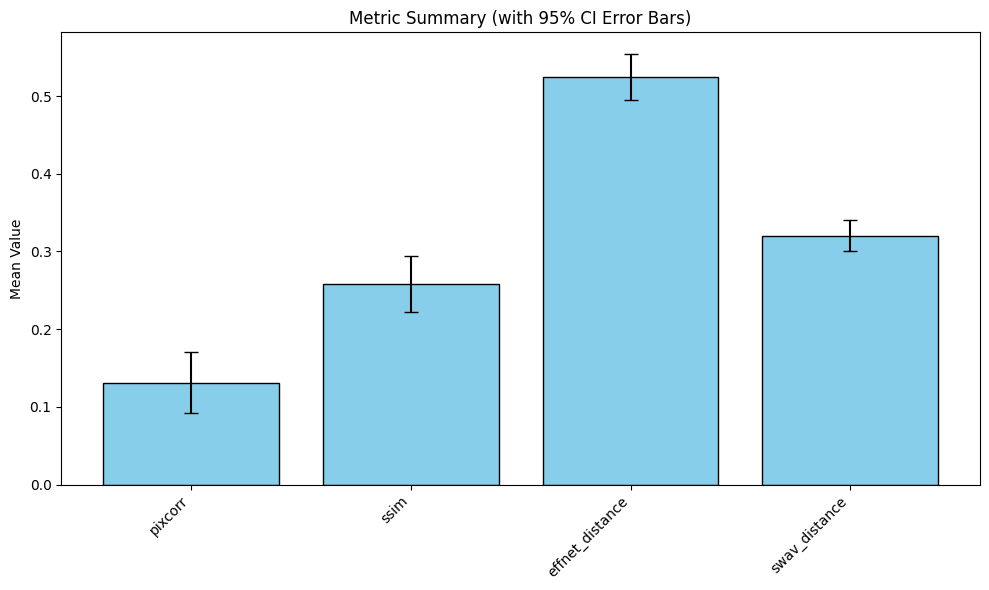

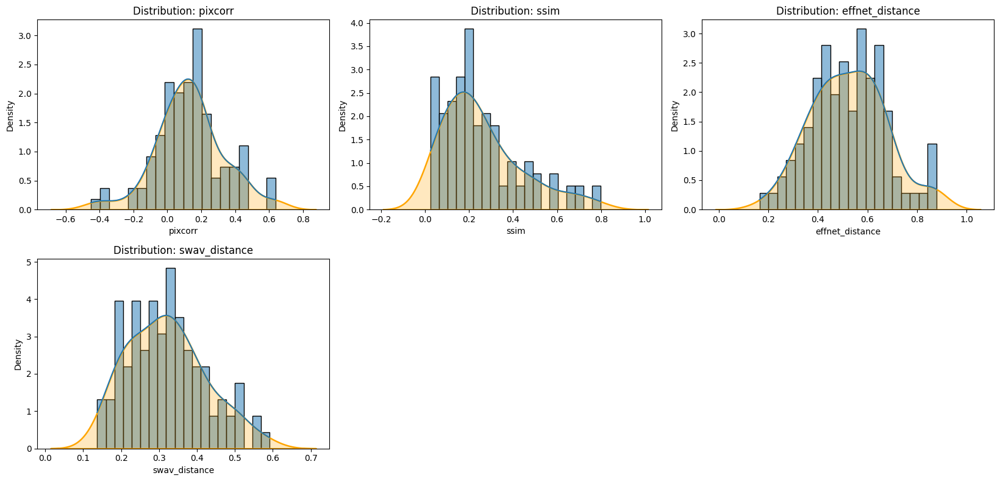

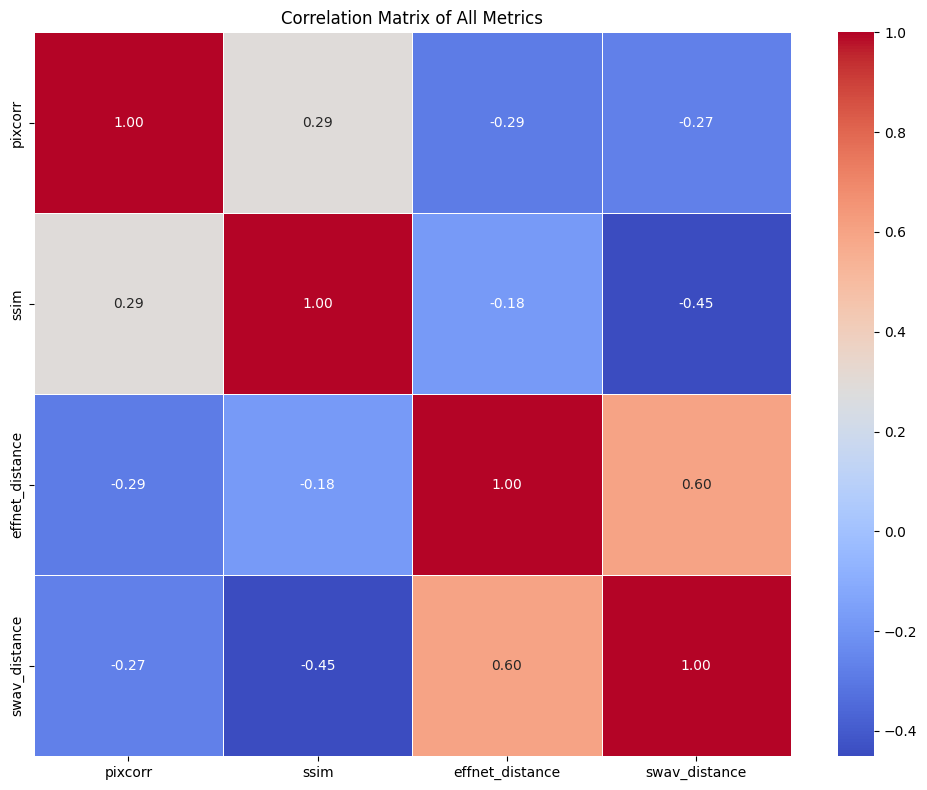

In [ ]:
def compute_summary_with_ci(df, confidence=0.95):
    n = len(df)
    means = df.mean()
    stds = df.std()
    se = df.apply(sem)
    h = se * t.ppf((1 + confidence) / 2., n - 1)
    lower = means - h
    upper = means + h

    summary_df = pd.DataFrame({
        "Mean": means.round(4),
        "Std": stds.round(4),
        f"{int(confidence*100)}% CI Lower": lower.round(4),
        f"{int(confidence*100)}% CI Upper": upper.round(4)
    })
    return summary_df

def plot_metric_distributions(metrics_path):
    # Load metrics
    df = pd.read_csv(metrics_path)

    # --- 1A. Summary Table: Mean ± Std ± CI ---
    summary_df = compute_summary_with_ci(df)

    print("✅ Metric Summary (Mean ± Std ± CI):\n")
    print(summary_df)

    # Save summary table
    summary_path = metrics_path.replace(".csv", "_summary.csv")
    summary_df.to_csv(summary_path)
    print(f"📁 Summary saved to {summary_path}")

    # --- 1B. Export to LaTeX ---
    latex_path = summary_path.replace("_summary.csv", "_summary.tex")
    with open(latex_path, "w") as f:
        f.write(summary_df.to_latex(float_format="%.4f", bold_rows=True))
    print(f"📄 LaTeX table exported to {latex_path}")

    # --- 1C. Bar Plot with Error Bars (95% CI) ---
    plt.figure(figsize=(10, 6))

    metrics = summary_df.index.tolist()
    means = summary_df["Mean"].values
    ci_error = (summary_df["95% CI Upper"] - summary_df["Mean"]).values

    plt.bar(metrics, means, yerr=ci_error, capsize=5, color='skyblue', edgecolor='black')
    plt.ylabel("Mean Value")
    plt.title("Metric Summary (with 95% CI Error Bars)")
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()

    # --- 2. Distribution Plots with Shaded CI (KDE fill) ---
    num_metrics = len(df.columns)
    num_cols = 3
    num_rows = -(-num_metrics // num_cols)  # Ceiling division

    fig, axes = plt.subplots(num_rows, num_cols, figsize=(num_cols * 5.5, num_rows * 4))
    axes = axes.flatten()

    for idx, column in enumerate(df.columns):
        sns.histplot(df[column], kde=True, bins=20, stat="density", ax=axes[idx])
        sns.kdeplot(df[column], fill=True, ax=axes[idx], color="orange", linewidth=1.8)
        axes[idx].set_title(f"Distribution: {column}")
        axes[idx].set_xlabel(column)
        axes[idx].set_ylabel("Density")

    # Hide any unused subplots
    for j in range(idx + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout()
    plt.show()

    # --- 3. Correlation Heatmap ---
    plt.figure(figsize=(10, 8))
    corr = df.corr()
    sns.heatmap(corr, annot=True, cmap="coolwarm", fmt=".2f", linewidths=0.5)
    plt.title("Correlation Matrix of All Metrics")
    plt.tight_layout()
    plt.show()

# ✅ Run the full analysis
metrics_path = f"{generated_dir}/initial_test_metric_results.csv"

plot_metric_distributions(metrics_path)

# TODO: Compare these numbers with the original Brain-diffuser paper

### 2. Learning Low-Level and High-Level Mappings for Reconstruction

We split this into two stages:
1. **Low-Level Reconstruction** - We train a regression model to map neural activity to the latent space of a pretrained VDVAE (Variational Diffusion VAE). This allows us to recover the coarse structure and spatial layout of the original image in a 64×64 resolution. These latent vectors (`z_pred`) capture low-level visual information like contours, textures, and object positions.
2. **High-Level Reconstruction** - We train a separate regression model to map neural activity to CLIP-Vision embeddings (ViT-L/14, 768-d). These embeddings encode global semantic concepts (e.g., object categories) and are later used to condition the diffusion model, guiding it to generate semantically accurate reconstructions (`clip_pred`).

Together, these two representations are fused in the final stage to produce high-resolution, semantically faithful images.

##### Load Extracted CLIP Features

In [ ]:
def load_clip_features(set_type):
    return np.load(f"/content/drive/My Drive/TVSD_Materials/saved/clip/features/{set_type}_clip_features.npy")

train_clip = load_clip_features("train")
test_clip = load_clip_features("test")

# Should be (N, 257, 768) for both
print('train_clip:', train_clip.shape)
print('test_clip:', test_clip.shape)

# ✅ Check alignment
assert train_MUA_N.shape[0] == train_clip.shape[0], "Train MUA and CLIP features mismatch!"
assert test_MUA_N.shape[0] == test_clip.shape[0], "Test MUA and CLIP features mismatch!"

assert train_MUA_F.shape[0] == train_clip.shape[0], "Train MUA and CLIP features mismatch!"
assert test_MUA_F.shape[0] == test_clip.shape[0], "Test MUA and CLIP features mismatch!"

##### Normalize MUA + CLIP Features

In [ ]:
# Normalize MUA data
train_MUA_N = train_MUA_N / np.linalg.norm(train_MUA_N, axis=1, keepdims=True)
test_MUA_N = test_MUA_N / np.linalg.norm(test_MUA_N, axis=1, keepdims=True)
print('train_MUA_N:', train_MUA_N.shape)
print('test_MUA_N:', test_MUA_N.shape)

train_MUA_F = train_MUA_F / np.linalg.norm(train_MUA_F, axis=1, keepdims=True)
test_MUA_F = test_MUA_F / np.linalg.norm(test_MUA_F, axis=1, keepdims=True)
print('train_MUA_F:', train_MUA_F.shape)
print('test_MUA_F:', test_MUA_F.shape)

train_MUA_N: (22248, 1024)
test_MUA_N: (100, 1024)
train_MUA_F: (22248, 1024)
test_MUA_F: (100, 1024)


In [ ]:
# Normalize CLIP features
train_clip = train_clip / np.linalg.norm(train_clip, axis=2, keepdims=True)
test_clip = test_clip / np.linalg.norm(test_clip, axis=2, keepdims=True)

#### 2.1 Stage 1: Low-Level Reconstruction - VDVAE Latents

Train a ridge regression model to map neural (MUA) data to **VDVAE latent vectors (𝑧)**. This stage focuses on recovering **low-level visual information** that captures structural and spatial layout of images at a 64x64 resolution, including edges, textures, etc.

**What is a VDVAE?**

A **VDVAE (Very Deep Variational Autoencoder)** is a type of generative model that is particularly useful for learning the latent representation of data. A VDVAE is designed to learn compact, low-dimensional representations (latent variables) of input data, such as images, in an unsupervised manner. The model captures both the global structure (overall layout) and local features (such as textures, edges, and shapes) of images.

**Why VDVAE?**

In our case, the VDVAE is used to encode visual features of images into a compact latent space, where it can capture essential image structures such as textures, edges, and basic object shapes at a relatively low resolution (64x64 pixels). These low-level features are critical because they form the building blocks for the overall image structure. This stage focuses on recovering these coarse visual details without considering the high-level semantic context (such as object identity or categories).

##### 1. Resize Images to 64 x 64

In [ ]:
def resize_and_save_images(image_paths, output_dir, size=(64, 64)):
    os.makedirs(output_dir, exist_ok=True)

    for img_path in tqdm(image_paths, desc=f"Resizing images to {size}"):
        try:
            filename = os.path.basename(img_path)
            save_path = os.path.join(output_dir, filename)

            # If save path exists, continue
            if os.path.exists(save_path):
                continue

            img = Image.open(img_path).convert("RGB")
            img = img.resize(size, Image.LANCZOS)

            img.save(save_path)
        except Exception as e:
            print(f"Error processing {img_path}: {e}")

# Where to put the resized images
train_output_dir = '/content/drive/My Drive/TVSD_Materials/data/resized_images_64/train'
test_output_dir  = '/content/drive/My Drive/TVSD_Materials/data/resized_images_64/test'

# Resize and save
resize_and_save_images(train_image_paths, train_output_dir)
resize_and_save_images(test_image_paths, test_output_dir)

Resizing images to (64, 64):   0%|          | 0/22248 [00:00<?, ?it/s]

##### 2. Initialize VDVAE & Extract 64×64 Latent Representations

We initialize the pretrained VDVAE model trained on ImageNet64 by loading its configuration and weights. We also set up the transformation pipeline for the 64×64 resized NSD stimuli images and define the latent extraction function. This function encodes each image and extracts the first 31 latent blocks from the decoder, flattening and saving them as a 91,168-dimensional vector per image. Latents for both the training and test images are saved as `.npy` files for downstream analysis.

In [ ]:
# ---- Load Hyperparameters for ImageNet64 ----
H_dict = hps.HPARAMS_REGISTRY['imagenet64']
H = SimpleNamespace(**H_dict)

# ✅ Add required missing attributes manually
H.image_size = 64
H.image_channels = 3
H.custom_width_str = ''
H.bottleneck_multiple = 0.25
H.num_mixtures = 10
H.no_bias_above = 64

In [ ]:
# ---- Paths ----
train_dir = '/content/drive/My Drive/TVSD_Materials/data/resized_images_64/train'
test_dir  = '/content/drive/My Drive/TVSD_Materials/data/resized_images_64/test'
save_dir  = '/content/drive/My Drive/TVSD_Materials/brain-diffuser/vdvae/saved'
os.makedirs(save_dir, exist_ok=True)

In [ ]:
# ---- Load Pretrained Model ----
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
vae = VAE(H).to(device)

# Fix DataParallel "module." prefix issue
state_dict = torch.load(
    '/content/drive/MyDrive/TVSD_Materials/brain-diffuser/vdvae/model/imagenet64-iter-1600000-model.th',
    map_location=device
)
# Remove 'module.' prefix
new_state_dict = {k.replace("module.", ""): v for k, v in state_dict.items()}
vae.load_state_dict(new_state_dict)

vae.eval()

VAE(
  (encoder): Encoder(
    (in_conv): Conv2d(3, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (enc_blocks): ModuleList(
      (0-59): 60 x Block(
        (c1): Conv2d(512, 128, kernel_size=(1, 1), stride=(1, 1))
        (c2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (c3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (c4): Conv2d(128, 512, kernel_size=(1, 1), stride=(1, 1))
      )
      (60-64): 5 x Block(
        (c1): Conv2d(512, 128, kernel_size=(1, 1), stride=(1, 1))
        (c2): Conv2d(128, 128, kernel_size=(1, 1), stride=(1, 1))
        (c3): Conv2d(128, 128, kernel_size=(1, 1), stride=(1, 1))
        (c4): Conv2d(128, 512, kernel_size=(1, 1), stride=(1, 1))
      )
    )
  )
  (decoder): Decoder(
    (dec_blocks): ModuleList(
      (0-1): 2 x DecBlock(
        (enc): Block(
          (c1): Conv2d(1024, 128, kernel_size=(1, 1), stride=(1, 1))
          (c2): Conv2d(128, 128, kernel_size=(1, 1), s

In [ ]:
# ---- Transform ----
transform = transforms.Compose([
    transforms.Resize(64),
    transforms.CenterCrop(64),
    transforms.ToTensor(),  # converts to [0,1]
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])  # [-1, 1]
])

In [ ]:
# ---- Extraction ----
def extract_latents(image_paths, save_path):
    if os.path.exists(save_path):
        print(f"✅ Latents already extracted: {save_path}")
        return

    latents = []
    for img_path in tqdm(image_paths, desc=f"Extracting from {len(image_paths)} images"):
        try:
            img = Image.open(img_path).convert("RGB")
            img_tensor = transform(img).unsqueeze(0).to(device)

            with torch.no_grad():
                activations = vae.encoder(img_tensor.permute(0, 2, 3, 1))
                _, stats = vae.decoder(activations, get_latents=True)

                latent_blocks = [stats[i]['z'].view(1, -1) for i in range(31)]
                z_flat = torch.cat(latent_blocks, dim=1)  # (1, 91168)
                assert len(latent_blocks) == 31, f"Expected 31 latent blocks, got {len(latent_blocks)}"
                assert z_flat.shape[1] == 91168, f"Expected shape (1, 91168), got {z_flat.shape}"
                latents.append(z_flat.squeeze(0).cpu().numpy())
                # latents.append(z_flat.clone().detach().squeeze(0).cpu().numpy())
                del activations, stats, latent_blocks, z_flat
                gc.collect()

        except Exception as e:
            print(f"Error on {img_path}: {e}")

    latents = np.stack(latents)
    np.save(save_path, latents)
    print(f"✅ Saved: {save_path}, shape: {latents.shape}")

In [ ]:
# ---- Run ----
train_image_paths = sorted(glob.glob(os.path.join(train_dir, '*.jpg')))
test_image_paths  = sorted(glob.glob(os.path.join(test_dir, '*.jpg')))

extract_latents(train_image_paths, os.path.join(save_dir, 'z_train.npy'))
extract_latents(test_image_paths,  os.path.join(save_dir, 'z_test.npy'))

✅ Latents already extracted: /content/drive/My Drive/TVSD_Materials/brain-diffuser/vdvae/saved/z_train.npy
✅ Latents already extracted: /content/drive/My Drive/TVSD_Materials/brain-diffuser/vdvae/saved/z_test.npy


##### 3. Train Ridge Regression Model to Map MUA --> VDVAE Latent Space

In [ ]:
def train_ridge_model(train_MUA, monkey_type):
    if os.path.exists(f'/content/drive/My Drive/TVSD_Materials/brain-diffuser/vdvae/saved/{monkey_type}_ridge_vdvae.pkl'):
        print(f"✅ Ridge model already exists: {monkey_type}_ridge_vdvae.pkl")
        return

    # Paths
    save_dir = '/content/drive/My Drive/TVSD_Materials/brain-diffuser/vdvae/saved'
    ridge_path = f'{save_dir}/{monkey_type}_ridge_vdvae.pkl'
    xscaler_path = f'{save_dir}/{monkey_type}_x_scaler.pkl'
    yscaler_path = f'{save_dir}/{monkey_type}_y_scaler.pkl'

    # Load latents
    z_train = np.load(f'{save_dir}/z_train.npy')  # shape: [N_train, 91168]

    # Scale inputs and outputs
    x_scaler = StandardScaler()
    train_MUA_scaled = x_scaler.fit_transform(train_MUA)

    y_scaler = StandardScaler()
    z_train_scaled = y_scaler.fit_transform(z_train)

    # === Train Ridge Regression ===
    ridge = Ridge(alpha=1e-4)  # Tune alpha as needed
    ridge.fit(train_MUA_scaled, z_train_scaled)

    # === Save everything ===
    joblib.dump(ridge, ridge_path)
    joblib.dump(x_scaler, xscaler_path)
    joblib.dump(y_scaler, yscaler_path)

    print(f"✅ Saved Ridge model, X-scaler, Y-scaler for monkey {monkey_type}")

train_ridge_model(train_MUA_N, 'N')
train_ridge_model(train_MUA_F, 'F')

✅ Ridge model already exists: N_ridge_vdvae.pkl
✅ Ridge model already exists: F_ridge_vdvae.pkl


##### 4. Predict Latents for Test Data

In [ ]:
def predict_test_data(test_MUA, monkey_type):
    save_dir = '/content/drive/My Drive/TVSD_Materials/brain-diffuser/vdvae/saved'
    z_pred_path = f'{save_dir}/{monkey_type}_z_pred.npy'

    if os.path.exists(z_pred_path):
        print(f"✅ Predicted test data already exists: {monkey_type}_z_pred.npy")
        return

    # === Load saved models ===
    ridge = joblib.load(f'{save_dir}/{monkey_type}_ridge_vdvae.pkl')
    x_scaler = joblib.load(f'{save_dir}/{monkey_type}_x_scaler.pkl')
    y_scaler = joblib.load(f'{save_dir}/{monkey_type}_y_scaler.pkl')

    # === Transform input ===
    test_MUA_scaled = x_scaler.transform(test_MUA)

    # === Predict in PCA space ===
    z_pred_scaled = ridge.predict(test_MUA_scaled)

    # === Invert Y-scaling ===
    z_pred = y_scaler.inverse_transform(z_pred_scaled)

    # === Save predictions ===
    np.save(z_pred_path, z_pred)
    print(f"✅ Predicted test data saved: {z_pred_path}")

predict_test_data(test_MUA_N, 'N')
predict_test_data(test_MUA_F, 'F')

✅ Predicted test data already exists: N_z_pred.npy
✅ Predicted test data already exists: F_z_pred.npy


##### 5. Visualize Coarse Image Reconstruction from VDVAE Latents

In this step, we use the **VDVAE decoder** to transform the predicted latent vectors (`z_pred`) from Stage 1 into **64×64 coarse reconstructed images**.

This allows us to visualize the low-level visual information that can be recovered directly from neural activity, before incorporating any semantic guidance. The latent vectors were rescaled based on the real latent distribution to improve stability and decoding performance.

In [ ]:
def infer_latent_shapes(vae, sample_image_tensor):
    """
    Returns a list of shapes for the latent z blocks by running VAE on a sample image.
    """
    sample_image_tensor = sample_image_tensor.to(device)
    with torch.no_grad():
        activations = vae.encoder(sample_image_tensor.permute(0, 2, 3, 1))  # NHWC
        _, stats = vae.decoder(activations, get_latents=True)
        latent_shapes = [stats[i]['z'].shape[1:] for i in range(len(stats))]
    return latent_shapes

In [ ]:
import torchvision.transforms.functional as TF

def plot_latent_histograms(real_latents, pred_latents):
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    # plt.plot(real_latents[:1000], label="Predicted")
    plt.hist(real_latents, bins=100, alpha=0.7, color='blue')
    plt.title('Real Latents Distribution')
    plt.xlabel('Value')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    # plt.plot(pred_latents[:1000], label="Real")
    plt.hist(pred_latents, bins=100, alpha=0.7, color='green')
    plt.title('Predicted Latents Distribution')
    plt.xlabel('Value')

    plt.tight_layout()
    plt.show()


def decode_from_latents(vae, monkey_type, test_image_paths=None, show_n=0):
    sample_img = Image.open(train_image_paths[0]).convert("RGB")
    sample_tensor = transform(sample_img).unsqueeze(0).to(device)
    latent_shapes = infer_latent_shapes(vae, sample_tensor)[:31]

    output_dir = f'/content/drive/MyDrive/TVSD_Materials/saved/clip/results/{monkey_type}/'
    os.makedirs(output_dir, exist_ok=True)

    with torch.no_grad():
        activations = vae.encoder(sample_tensor.permute(0, 2, 3, 1))
        _, stats = vae.decoder(activations, get_latents=True)
        real_latent_blocks = [stats[i]['z'].cpu().numpy() for i in range(31)]
        flat_real_latents = np.concatenate([z.flatten() for z in real_latent_blocks])
        np.save("/content/drive/MyDrive/TVSD_Materials/brain-diffuser/vdvae/saved/real_image_latents.npy", flat_real_latents)

    if monkey_type.startswith('stage1_'):
        monkey_type_corrected = monkey_type[7:]
    else:
        monkey_type_corrected = monkey_type

    flat_latent_path = f'/content/drive/MyDrive/TVSD_Materials/brain-diffuser/vdvae/saved/{monkey_type_corrected}_z_pred.npy'
    latents_np = np.load(flat_latent_path)
    real_latents = flat_real_latents

    total_dims = sum(np.prod(shape) for shape in latent_shapes)
    assert latents_np.shape[1] == total_dims, f"Mismatch: {latents_np.shape[1]} vs {total_dims}"

    for idx, flat in tqdm(enumerate(latents_np), total=len(latents_np), desc="Decoding"):
        try:
            rescale = True
            if rescale:
                start = 0
                for i, block_shape in enumerate(latent_shapes):
                    dim = np.prod(block_shape)
                    real_block = real_latents[start:start+dim]
                    pred_block = flat[start:start+dim]

                    mean_real = real_block.mean()
                    std_real = real_block.std()
                    mean_pred = pred_block.mean()
                    std_pred = pred_block.std()

                    if std_pred > 1e-5:
                        pred_block = (pred_block - mean_pred) * (std_real / std_pred) + mean_real
                    else:
                        print(f"[Warning] Block {i} std_pred too small, skipping.")

                    flat[start:start+dim] = pred_block
                    start += dim

            flat = np.nan_to_num(flat, nan=0.0, posinf=0.0, neginf=0.0)

            start = 0
            latent_blocks = []
            for shape in latent_shapes:
                dim = np.prod(shape)
                block = flat[start:start+dim].reshape((1, *shape))
                latent_blocks.append(torch.tensor(block, dtype=torch.float32, device=device).detach())
                start += dim

            full_latent_shapes = infer_latent_shapes(vae, sample_tensor)
            latent_blocks += [
                torch.zeros((1, *shape), dtype=torch.float32, device=device)
                for shape in full_latent_shapes[len(latent_shapes):]
            ]

            with torch.no_grad():
                px_z = vae.decoder.forward_manual_latents(1, latent_blocks)
                recon = vae.decoder.out_net.sample(px_z)

                if isinstance(recon, np.ndarray):
                    recon = torch.from_numpy(recon).permute(0, 3, 1, 2).float().div(255.).to(device)
                else:
                    recon = recon.permute(0, 3, 1, 2).float().to(device)

                recon = recon.clamp(0, 1).to(torch.float32)

                save_path = os.path.join(output_dir, f"{monkey_type}_{idx}.png")
                save_image(recon, save_path)

                if idx < show_n:
                    img_to_show = TF.to_pil_image(recon.squeeze(0).cpu())
                    plt.figure()
                    plt.title(f"{monkey_type} - Reconstructed #{idx}")
                    plt.imshow(img_to_show)
                    plt.axis('off')
                    plt.show()

            del latent_blocks, recon
            gc.collect()

        except Exception as e:
            print(f"Failed to decode image {idx}: {e}")

    if test_image_paths is not None:
        from IPython.display import display
        df = plot_generated_vs_ground_truth_from_scratch(
            output_dir, test_image_paths, monkey_type, num_images=min(100, len(test_image_paths))
        )
        display(df)


In [ ]:
# def plot_latent_histograms(real_latents, pred_latents):
#     plt.figure(figsize=(12, 5))

#     plt.subplot(1, 2, 1)
#     # plt.plot(real_latents[:1000], label="Predicted")
#     plt.hist(real_latents, bins=100, alpha=0.7, color='blue')
#     plt.title('Real Latents Distribution')
#     plt.xlabel('Value')
#     plt.ylabel('Frequency')

#     plt.subplot(1, 2, 2)
#     # plt.plot(pred_latents[:1000], label="Real")
#     plt.hist(pred_latents, bins=100, alpha=0.7, color='green')
#     plt.title('Predicted Latents Distribution')
#     plt.xlabel('Value')

#     plt.tight_layout()
#     plt.show()

# def decode_from_latents(vae, monkey_type, test_image_paths=None, show_n=0):
#     sample_img = Image.open(train_image_paths[0]).convert("RGB")
#     sample_tensor = transform(sample_img).unsqueeze(0).to(device)
#     latent_shapes = infer_latent_shapes(vae, sample_tensor)[:31]

#     output_dir = f'/content/drive/MyDrive/TVSD_Materials/saved/clip/results/{monkey_type}/'
#     os.makedirs(output_dir, exist_ok=True)

#     # Step 1: Extract latent stats for real image
#     with torch.no_grad():
#         activations = vae.encoder(sample_tensor.permute(0, 2, 3, 1))
#         _, stats = vae.decoder(activations, get_latents=True)
#         real_latent_blocks = [stats[i]['z'].cpu().numpy() for i in range(31)]
#         flat_real_latents = np.concatenate([z.flatten() for z in real_latent_blocks])

#     # Step 2: Load predicted latents
#     if monkey_type.startswith('stage1_'):
#         monkey_type_corrected = monkey_type[7:]
#     else:
#         monkey_type_corrected = monkey_type

#     flat_latent_path = f'/content/drive/MyDrive/TVSD_Materials/brain-diffuser/vdvae/saved/{monkey_type_corrected}_z_pred.npy'
#     latents_np = np.load(flat_latent_path)
#     total_dims = sum(np.prod(shape) for shape in latent_shapes)
#     assert latents_np.shape[1] == total_dims, f"Mismatch: {latents_np.shape[1]} vs {total_dims}"

#     # Step 3: Decode predicted latents into images
#     for idx, flat in tqdm(enumerate(latents_np), total=len(latents_np), desc="Decoding"):
#         try:
#             # Re-scale predicted latents to match real latent distribution
#             rescale = True
#             if rescale:
#                 start = 0
#                 for i, block_shape in enumerate(latent_shapes):
#                     dim = np.prod(block_shape)
#                     real_block = flat_real_latents[start:start+dim]
#                     pred_block = flat[start:start+dim]
#                     mean_real, std_real = real_block.mean(), real_block.std()
#                     mean_pred, std_pred = pred_block.mean(), pred_block.std()
#                     if std_pred > 1e-5:
#                         pred_block = (pred_block - mean_pred) * (std_real / std_pred) + mean_real
#                     flat[start:start+dim] = pred_block
#                     start += dim

#             flat = np.nan_to_num(flat, nan=0.0, posinf=0.0, neginf=0.0)

#             # Convert to latent blocks
#             start = 0
#             latent_blocks = []
#             for shape in latent_shapes:
#                 dim = np.prod(shape)
#                 block = flat[start:start+dim].reshape((1, *shape))
#                 latent_blocks.append(torch.tensor(block, dtype=torch.float32, device=device).detach())
#                 start += dim

#             # Pad remaining blocks
#             full_latent_shapes = infer_latent_shapes(vae, sample_tensor)
#             latent_blocks += [
#                 torch.zeros((1, *shape), dtype=torch.float32, device=device)
#                 for shape in full_latent_shapes[len(latent_shapes):]
#             ]

#             # Decode image
#             with torch.no_grad():
#                 px_z = vae.decoder.forward_manual_latents(1, latent_blocks)
#                 recon = vae.decoder.out_net.sample(px_z)
#                 if isinstance(recon, np.ndarray):
#                     recon = torch.from_numpy(recon).permute(0, 3, 1, 2).float().div(255.).to(device)
#                 else:
#                     recon = recon.permute(0, 3, 1, 2).float().to(device)
#                 recon = recon.clamp(0, 1)

#             save_path = os.path.join(output_dir, f"{monkey_type}_{idx}.png")
#             save_image(recon, save_path)

#             if idx < show_n:
#                 img_to_show = TF.to_pil_image(recon.squeeze(0).cpu())
#                 plt.figure()
#                 plt.title(f"{monkey_type} - Reconstructed #{idx}")
#                 plt.imshow(img_to_show)
#                 plt.axis('off')
#                 plt.show()

#             del latent_blocks, recon
#             gc.collect()

#         except Exception as e:
#             print(f"Failed to decode image {idx}: {e}")

#     # Step 4: Evaluate decoded images (using updated one-vs-all logic)
#     if test_image_paths is not None:
#         from IPython.display import display
#         df = plot_generated_vs_ground_truth_from_scratch(
#             generated_dir=output_dir,
#             test_image_paths=test_image_paths,
#             monkey_type=monkey_type,
#             num_images=min(100, len(test_image_paths))
#         )
#         display(df)


In [ ]:
# Then decode saved latent vectors:
decode_from_latents(vae, monkey_type='stage1_N', test_image_paths=test_image_paths)
#plot_metric_distributions(f'/content/drive/MyDrive/TVSD_Materials/saved/clip/results/stage1_N/stage1_N_metric_results.csv')

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
decode_from_latents(vae, monkey_type='stage1_F', test_image_paths=test_image_paths)
#plot_metric_distributions(f'/content/drive/MyDrive/TVSD_Materials/saved/clip/results/stage1_F/stage1_F_metric_results.csv')

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
# def decode_unconditional_sample(vae, output_path='uncond_sample.png'):
#     with torch.no_grad():
#         px_z = vae.decoder.forward_uncond(n=1)
#         recon = vae.decoder.out_net.sample(px_z)
#         print("Raw recon shape:", recon.shape)
#         print("Raw recon min:", recon.min())
#         print("Raw recon max:", recon.max())
#         print("Raw recon dtype:", recon.dtype)

#     if isinstance(recon, np.ndarray):
#         # Scale to [0, 1], convert to float32, and permute to NCHW
#         recon = torch.from_numpy(recon).permute(0, 3, 1, 2).float().div(255.).to(device)
#     else:
#         recon = recon.permute(0, 3, 1, 2).float().to(device)

#     recon = recon.clamp(0, 1)
#     save_image(recon, output_path)

# decode_unconditional_sample(vae, '/content/drive/MyDrive/TVSD_Materials/brain-diffuser/vdvae/recon_images/uncond_sample1.png')

In [ ]:
# def decode_from_real_image(vae, image_path):
#     img = Image.open(image_path).convert("RGB")
#     img_tensor = transform(img).unsqueeze(0).to(device)

#     with torch.no_grad():
#         activations = vae.encoder(img_tensor.permute(0, 2, 3, 1))
#         _, stats = vae.decoder(activations, get_latents=True)
#         latent_blocks = [stats[i]['z'] for i in range(31)]
#         px_z = vae.decoder.forward_manual_latents(1, latent_blocks)
#         recon = vae.decoder.out_net.sample(px_z)

#     if isinstance(recon, np.ndarray):
#         recon = torch.from_numpy(recon).permute(0, 3, 1, 2).float().div(255.).to(device)
#     else:
#         recon = recon.permute(0, 3, 1, 2).float().to(device)

#     recon = recon.clamp(0, 1).to(torch.float32)
#     save_image(recon, '/content/drive/MyDrive/TVSD_Materials/brain-diffuser/vdvae/recon_images/reconstructed_real_image.png')

# decode_from_real_image(vae, train_image_paths[0])

#### 2.2  Stage 2: High-Level Reconstruction - CLIP Embeddings

In this stage, we train a ridge regression model to map neural data to **high-level semantic features** of images through **CLIP image embeddings (ViT-L/14, 768-d)**. This stage is about recovering **global semantic** concepts, such as object categories and relationships between them, even when the coarse VDVAE reconstruction is blurry.

In [ ]:
import numpy as np

# === Load precomputed CLIP features ===
clip_train = np.load("/content/drive/My Drive/TVSD_Materials/saved/clip/features/train_clip_features.npy")  # shape: (N, 257, 768)
clip_test = np.load("/content/drive/My Drive/TVSD_Materials/saved/clip/features/test_clip_features.npy")    # shape: (N, 257, 768)

assert clip_train.shape[0] == len(train_image_paths)
assert clip_test.shape[0] == len(test_image_paths)

assert clip_train.shape[1] == 257
assert clip_train.shape[2] == 768

assert clip_test.shape[1] == 257
assert clip_test.shape[2] == 768

# === Flatten CLIP features to (N, 197376) vectors ===
clip_train_flat = clip_train.reshape(clip_train.shape[0], -1)
clip_test_flat = clip_test.reshape(clip_test.shape[0], -1)

In [ ]:
def train_clip_regression(train_MUA, clip_targets_flat, monkey_type):
    if os.path.exists(f"/workspace/TVSD_Materials/saved/clip/model/{monkey_type}_ridge_clip.pkl"):
        print(f"✅ Ridge model already exists: {monkey_type}_ridge_clip.pkl")
        return

    save_dir = "/workspace/TVSD_Materials/saved/clip/model/"
    os.makedirs(save_dir, exist_ok=True)

    # Scale the data using the existing scaler
    x_scaler = StandardScaler()
    y_scaler = StandardScaler()

    train_MUA_scaled = x_scaler.fit_transform(train_MUA)
    clip_targets_scaled = y_scaler.fit_transform(clip_targets_flat)

    # Apply PCA transformation
    # train_MUA = pca.transform(train_MUA_scaled)  # Apply PCA to the MUA data
    ridge = Ridge(alpha=1e-4)
    ridge.fit(train_MUA_scaled, clip_targets_scaled)

    # Save model + scalers
    joblib.dump(ridge, f"{save_dir}/{monkey_type}_ridge_clip.pkl")
    joblib.dump(x_scaler, f"{save_dir}/{monkey_type}_x_scaler_clip.pkl")
    joblib.dump(y_scaler, f"{save_dir}/{monkey_type}_y_scaler_clip.pkl")

    print(f"Trained and saved CLIP ridge regression model for monkey {monkey_type}")

train_clip_regression(train_MUA_N, clip_train_flat, 'N')
train_clip_regression(train_MUA_F, clip_train_flat, 'F')

In [ ]:
def predict_clip_features(test_MUA, monkey_type):
    save_dir = "/workspace/TVSD_Materials/saved/clip/model/"
    ridge = joblib.load(f"{save_dir}/{monkey_type}_ridge_clip.pkl")
    x_scaler = joblib.load(f"{save_dir}/{monkey_type}_x_scaler_clip.pkl")
    y_scaler = joblib.load(f"{save_dir}/{monkey_type}_y_scaler_clip.pkl")

    test_scaled = x_scaler.transform(test_MUA)
    clip_pred_scaled = ridge.predict(test_scaled)
    clip_pred = y_scaler.inverse_transform(clip_pred_scaled)

    # Reshape the predicted CLIP features to (N, 257, 768)
    N = clip_pred.shape[0]  # Number of samples
    clip_pred = clip_pred.reshape(N, 257, 768)  # Reshaping to (N, 257, 768)

    # Save predicted CLIP features
    out_path = f"/workspace/TVSD_Materials/saved/clip/saved/{monkey_type}_clip_pred.npy"
    os.makedirs(os.path.dirname(out_path), exist_ok=True)
    np.save(out_path, clip_pred)
    print(f"✅ Saved predicted CLIP features for {monkey_type} at {out_path}")

# Predict for both monkeys
predict_clip_features(test_MUA_N, "N")
predict_clip_features(test_MUA_F, "F")

✅ Ridge regression model for monkey N already exists
✅ Ridge regression model for monkey F already exists


### 3. Evaluate Overall Results

#### 3.1 Stage 3: Coarse-to-Fine Reconstruction: Using VDVAE Outputs and Predicted CLIP Features

In this final stage, we initialize the Versatile Diffusion model with the low-level structure provided by the **VDVAE-reconstructed images (coarse prior)**. We then condition it using the **predicted CLIP vision embeddings (high-level semantic features)** derived from neural activity (MUA). This process enables us to generate fine, high-resolution, and semantically accurate reconstructions.

/content/drive/.shortcut-targets-by-id/1pu2z08XCHHoOBNnZQoV5BbP0PlvFf4Pk/TVSD_Materials/brain-diffuser
Generating test images for Monkey N
Running command:
python scripts/versatilediffusion_reconstruct_images.py         --sub 1         --clip_features "/content/drive/My Drive/TVSD_Materials/saved/clip/saved/N_clip_pred.npy"         --output_dir "/content/drive/My Drive/TVSD_Materials/saved/clip/results/N"         --monkey_type "N" --init_image_dir "/content/drive/MyDrive/TVSD_Materials/saved/clip/results/stage1_N/"
/content/drive/My Drive/TVSD_Materials/saved/clip/results/N/N_metric_results.csv


Plotting Images....: 100%|██████████| 100/100 [00:23<00:00,  4.32it/s]


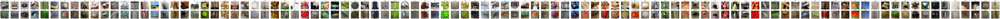

✅ Metrics saved to /content/drive/My Drive/TVSD_Materials/saved/clip/results/N/N_metric_results.csv


,clip_cosine,ssim,pixcorr,alexnet2,alexnet5,inception_distance,effnet_distance,swav_distance
0,0.491265,0.092312,0.064430,0.367462,0.053310,0.887754,0.937046,0.717193
1,0.479580,0.525207,0.153542,0.086768,0.056645,1.048835,0.996797,0.705340
2,0.578732,0.584814,0.500792,0.174029,0.274505,0.875777,0.766587,0.643982
3,0.500539,0.369896,0.124217,0.207960,0.079824,0.985706,0.937306,0.667896
4,0.545735,0.127523,0.296757,0.322002,0.402093,0.692928,0.650015,0.598233
...,...,...,...,...,...,...,...,...
95,0.554109,0.533053,0.330938,0.144219,0.110546,0.830356,0.926345,0.755603
96,0.552476,0.578616,0.455128,0.123145,0.158518,0.850306,0.895223,0.592846
97,0.560482,0.513564,0.469671,0.195396,0.168950,1.032953,1.010280,0.690258
98,0.562078,0.185822,0.185543,0.223985,0.324629,0.835356,0.657915,0.562275


✅ Metric Summary (Mean ± Std ± CI):

                      Mean     Std  95% CI Lower  95% CI Upper
clip_cosine         0.5273  0.0389        0.5196        0.5350
ssim                0.4155  0.1734        0.3811        0.4499
pixcorr             0.3229  0.1648        0.2902        0.3556
alexnet2            0.1978  0.0610        0.1857        0.2099
alexnet5            0.1344  0.0696        0.1206        0.1482
inception_distance  0.9026  0.0933        0.8841        0.9211
effnet_distance     0.8842  0.1034        0.8637        0.9048
swav_distance       0.6650  0.0739        0.6503        0.6797
📁 Summary saved to /content/drive/My Drive/TVSD_Materials/saved/clip/results/N/N_metric_results_summary.csv
📄 LaTeX table exported to /content/drive/My Drive/TVSD_Materials/saved/clip/results/N/N_metric_results_summary.tex


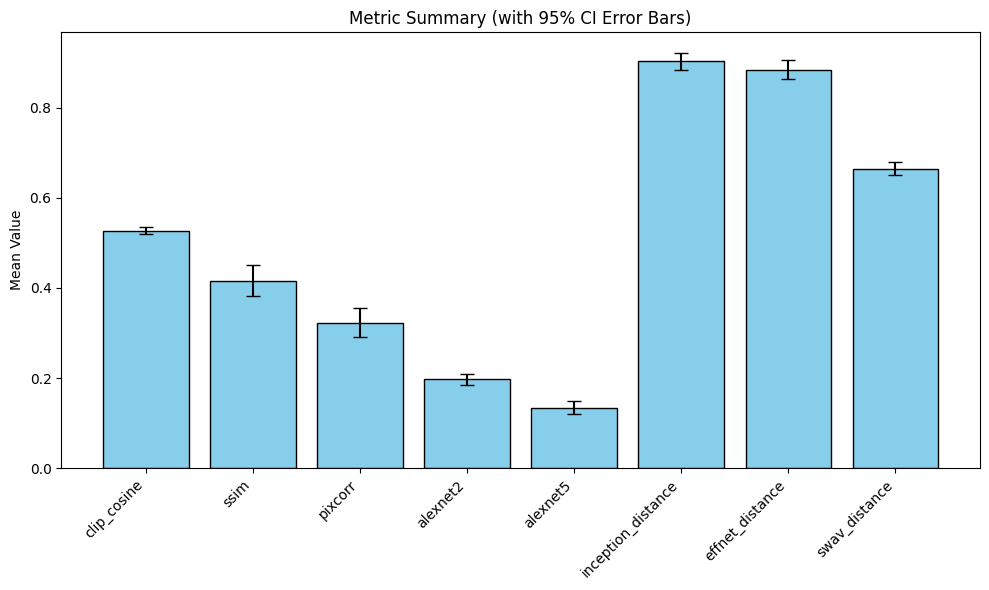

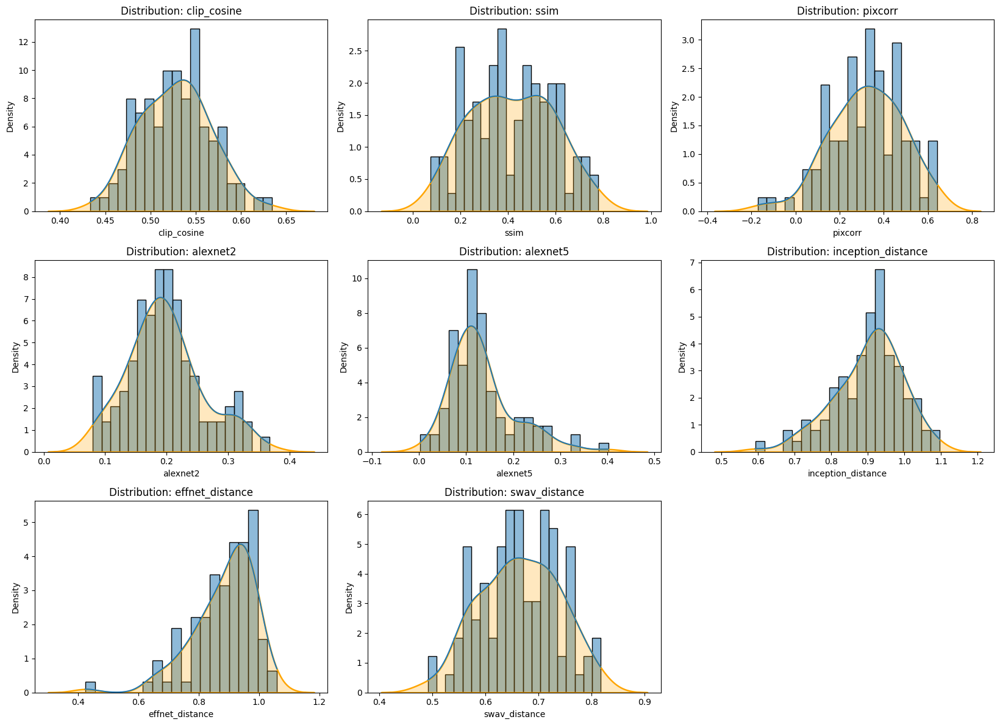

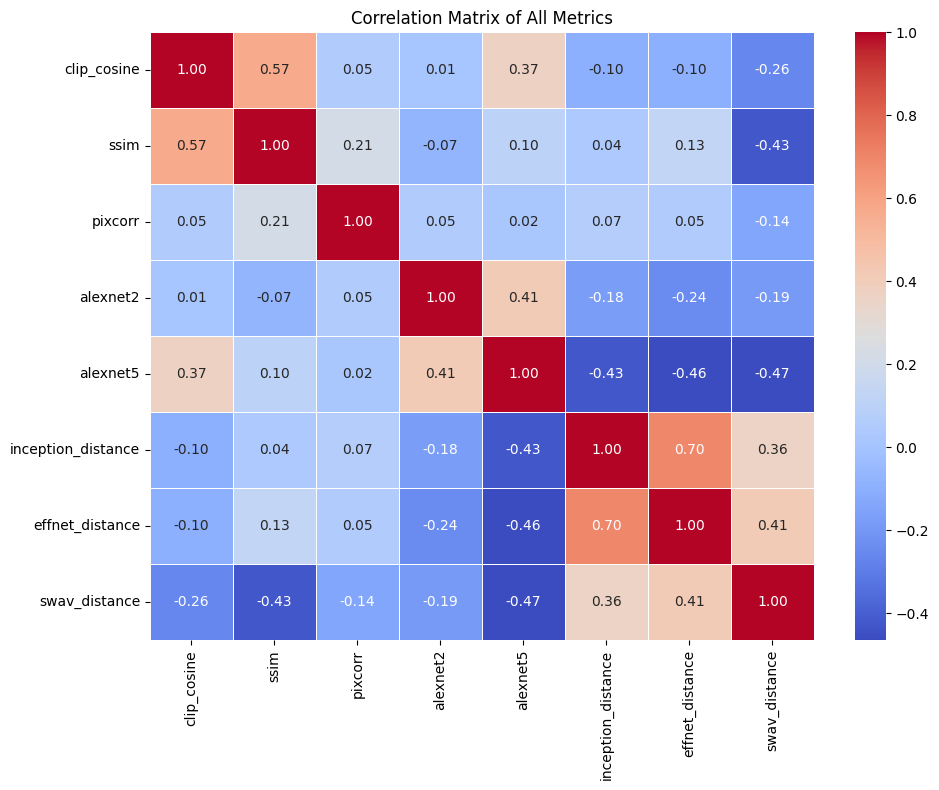

In [ ]:
# Generate images + visualize results
generated_dir_N = generate_images(f"/content/drive/My Drive/TVSD_Materials/saved/clip/saved/N_clip_pred.npy", 'N', init_image_dir='/content/drive/MyDrive/TVSD_Materials/saved/clip/results/stage1_N/')
df = plot_generated_vs_ground_truth(generated_dir_N, test_image_paths, 'N')
display(df)
plot_metric_distributions(os.path.join(generated_dir_N, "N_metric_results.csv"))

/content/drive/.shortcut-targets-by-id/1pu2z08XCHHoOBNnZQoV5BbP0PlvFf4Pk/TVSD_Materials/brain-diffuser
Generating test images for Monkey F
Running command:
python scripts/versatilediffusion_reconstruct_images.py         --sub 1         --clip_features "/content/drive/My Drive/TVSD_Materials/saved/clip/saved/F_clip_pred.npy"         --output_dir "/content/drive/My Drive/TVSD_Materials/saved/clip/results/F"         --monkey_type "F" --init_image_dir "/content/drive/MyDrive/TVSD_Materials/saved/clip/results/stage1_F/"
/content/drive/My Drive/TVSD_Materials/saved/clip/results/F/F_metric_results.csv


Plotting Images....: 100%|██████████| 100/100 [00:23<00:00,  4.33it/s]


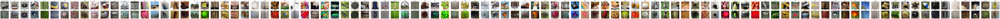

✅ Metrics saved to /content/drive/My Drive/TVSD_Materials/saved/clip/results/F/F_metric_results.csv


,clip_cosine,ssim,pixcorr,alexnet2,alexnet5,inception_distance,effnet_distance,swav_distance
0,0.488529,0.081048,0.009658,0.390122,0.070986,0.945827,0.925240,0.730212
1,0.491650,0.527667,0.250515,0.134197,0.152483,0.972401,1.014487,0.654895
2,0.592075,0.655180,0.622974,0.272644,0.318402,0.875379,0.816465,0.630345
3,0.482024,0.296030,0.075327,0.243242,0.088670,0.907058,0.921090,0.657871
4,0.563727,0.121212,0.328538,0.385331,0.451285,0.614448,0.614279,0.642211
...,...,...,...,...,...,...,...,...
95,0.548981,0.586157,0.432576,0.197421,0.174422,0.946036,0.849037,0.678404
96,0.509852,0.483878,0.250232,0.144506,0.082241,0.907331,0.973050,0.654985
97,0.544782,0.480902,0.397652,0.120729,0.146600,0.881597,0.953418,0.592106
98,0.554488,0.117766,0.223755,0.142920,0.251719,0.865854,0.871648,0.610623


✅ Metric Summary (Mean ± Std ± CI):

                      Mean     Std  95% CI Lower  95% CI Upper
clip_cosine         0.5297  0.0377        0.5222        0.5371
ssim                0.4140  0.1795        0.3784        0.4496
pixcorr             0.3535  0.1712        0.3195        0.3875
alexnet2            0.2040  0.0738        0.1893        0.2186
alexnet5            0.1409  0.0756        0.1259        0.1559
inception_distance  0.8825  0.1025        0.8622        0.9029
effnet_distance     0.8682  0.0993        0.8485        0.8879
swav_distance       0.6439  0.0793        0.6282        0.6596
📁 Summary saved to /content/drive/My Drive/TVSD_Materials/saved/clip/results/F/F_metric_results_summary.csv
📄 LaTeX table exported to /content/drive/My Drive/TVSD_Materials/saved/clip/results/F/F_metric_results_summary.tex


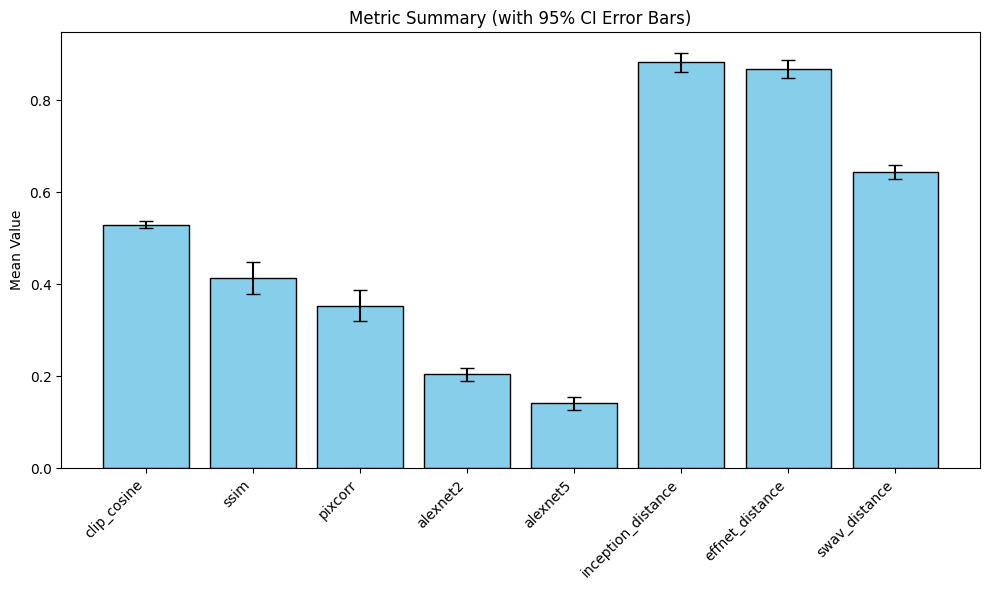

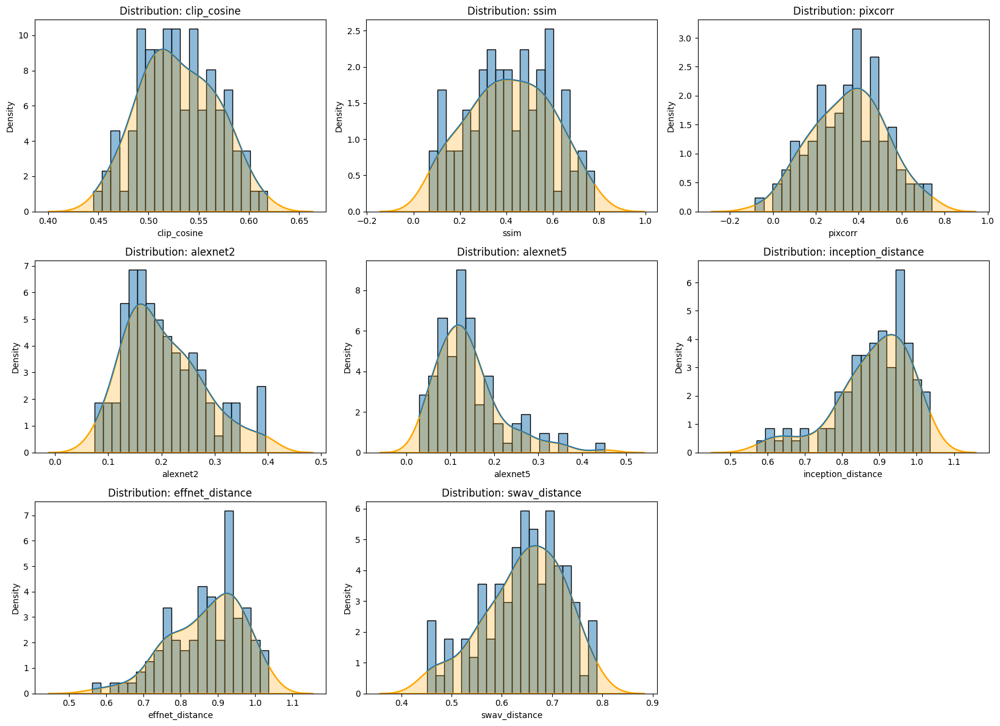

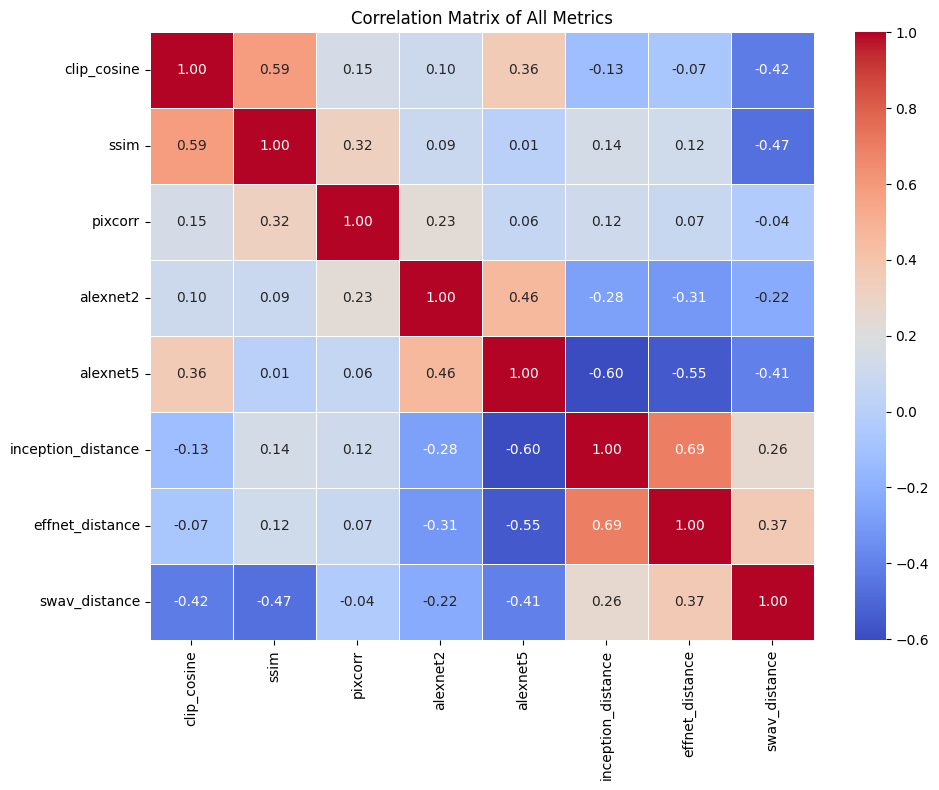

In [ ]:
# Generate images + visualize results
generated_dir_F = generate_images(f"/content/drive/My Drive/TVSD_Materials/saved/clip/saved/F_clip_pred.npy", 'F', init_image_dir='/content/drive/MyDrive/TVSD_Materials/saved/clip/results/stage1_F/')
df = plot_generated_vs_ground_truth(generated_dir_F, test_image_paths, 'F')
display(df)
plot_metric_distributions(os.path.join(generated_dir_F, "F_metric_results.csv"))

#### 3.2 Plot PCA + t-SNE

In [ ]:
# TODO: One of the assigned members

#### 3.3 Evaluate Metrics - Cosine Similarity, MSE, and Correlation

In [ ]:
# TODO: One of the assigned members

In [ ]:
# def plot_pca(true_features, predicted_features, monkey_type, n_components=2):
#     # Apply the same StandardScaler to both
#     scaler = StandardScaler()
#     all_features = np.vstack([true_features, predicted_features])
#     all_scaled = scaler.fit_transform(all_features)
#     true_scaled = all_scaled[:len(true_features)]
#     predicted_scaled = all_scaled[len(true_features):]

#     # Reduce to 2D with PCA
#     pca = PCA(n_components=2).fit(true_scaled)
#     pca_true = pca.transform(true_scaled)
#     pca_predicted = pca.transform(predicted_scaled)

#     # Plot
#     plt.figure(figsize=(8, 6))
#     plt.scatter(pca_true[:, 0], pca_true[:, 1], color='blue', label="True Spatial Features")
#     plt.scatter(pca_predicted[:, 0], pca_predicted[:, 1], color='red', label="Predicted Spatial Features")
#     plt.xlabel("PCA Component 1")
#     plt.ylabel("PCA Component 2")
#     plt.title(f"PCA Visualization of True vs. Predicted Spatial Features for Monkey {monkey_type}")
#     plt.legend()
#     plt.show()

In [ ]:
# plot_pca(true_combined_features, predicted_combined_features_N, 'N')
# plot_pca(true_combined_features, predicted_combined_features_F, 'F')

In [ ]:
# def plot_tsne(true_features, predicted_features, monkey_type, perplexity=30):
#     # ✅ Combine the data
#     combined_features = np.vstack([true_features, predicted_features])

#     print("Avg norm of true features:", np.mean(np.linalg.norm(true_features, axis=1)))
#     print("Avg norm of predicted features:", np.mean(np.linalg.norm(predicted_features, axis=1)))

#     # ✅ Apply t-SNE to the combined features
#     tsne = TSNE(n_components=2, perplexity=perplexity, random_state=42)
#     combined_tsne = tsne.fit_transform(combined_features)

#     # ✅ Split back to true and predicted
#     true_tsne = combined_tsne[:len(true_features)]
#     predicted_tsne = combined_tsne[len(true_features):]

#     # ✅ Plot True vs. Predicted CLS Features
#     plt.figure(figsize=(8, 6))
#     plt.scatter(true_tsne[:, 0], true_tsne[:, 1], color='blue', label='True Spatial Features', alpha=0.6)
#     plt.scatter(predicted_tsne[:, 0], predicted_tsne[:, 1], color='red', label='Predicted Spatial Features', alpha=0.6)
#     plt.xlabel("t-SNE Component 1")
#     plt.ylabel("t-SNE Component 2")
#     plt.title(f"t-SNE Visualization of True vs. Predicted Spatial Features for Monkey {monkey_type}")
#     plt.legend()
#     plt.show()

In [ ]:
# plot_tsne(true_combined_features, predicted_combined_features_N, 'N')
# plot_tsne(true_combined_features, predicted_combined_features_F, 'F')

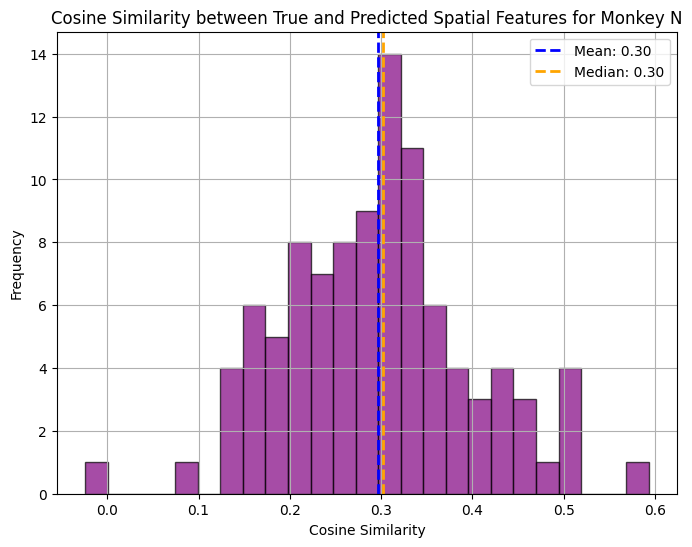

Monkey N - Cosine Similarity Stats:
Mean:   0.2962
Median: 0.3019
Std:    0.1045
Min:    -0.0243
Max:    0.5932


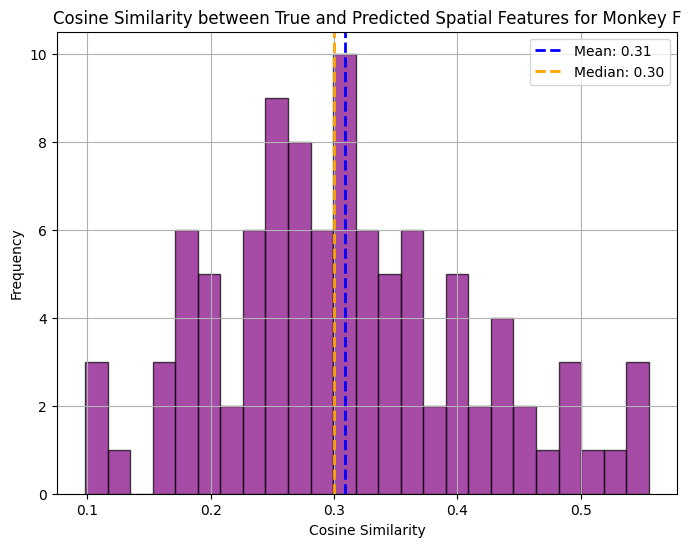

Monkey F - Cosine Similarity Stats:
Mean:   0.3085
Median: 0.3000
Std:    0.1030
Min:    0.0981
Max:    0.5552


In [ ]:
def plot_cosine_similarity(true_features, predicted_features, monkey_type):
    # ✅ Compute cosine similarities (per sample)
    similarities = np.sum(true_features * predicted_features, axis=1)

    # ✅ Plot histogram
    plt.figure(figsize=(8, 6))
    plt.hist(similarities, bins=25, color='purple', edgecolor='black', alpha=0.7)

    # Add vertical lines
    mean_val = np.mean(similarities)
    median_val = np.median(similarities)
    plt.axvline(mean_val, color='blue', linestyle='--', linewidth=2, label=f'Mean: {mean_val:.2f}')
    plt.axvline(median_val, color='orange', linestyle='--', linewidth=2, label=f'Median: {median_val:.2f}')

    # Plot labels
    plt.title(f'Cosine Similarity between True and Predicted Spatial Features for Monkey {monkey_type}')
    plt.xlabel('Cosine Similarity')
    plt.ylabel('Frequency')
    plt.legend()
    plt.grid(True)
    plt.show()

    # ✅ Print basic stats
    print(f"Monkey {monkey_type} - Cosine Similarity Stats:")
    print(f"Mean:   {mean_val:.4f}")
    print(f"Median: {median_val:.4f}")
    print(f"Std:    {np.std(similarities):.4f}")
    print(f"Min:    {np.min(similarities):.4f}")
    print(f"Max:    {np.max(similarities):.4f}")

plot_cosine_similarity(true_combined_features, predicted_combined_features_N, 'N')
plot_cosine_similarity(true_combined_features, predicted_combined_features_F, 'F')

In [ ]:
def evaluate_predictions(true_cls, predicted_cls, monkey_name):
    """ Computes cosine similarity, MSE, and Pearson correlation. """

    # ✅ 1. Cosine Similarity (Mean Across Samples)
    cos_sim = cosine_similarity(true_cls, predicted_cls).diagonal()  # Take diagonal for sample-wise similarity
    mean_cosine_sim = np.mean(cos_sim)

    # ✅ 2. MSE (Mean Squared Error)
    mse = np.mean((true_cls - predicted_cls) ** 2)

    # ✅ 3. Pearson Correlation (Mean Across CLS Features)
    pearson_corrs = [pearsonr(true_cls[:, i], predicted_cls[:, i])[0] for i in range(true_cls.shape[1])]
    mean_pearson_corr = np.mean(pearson_corrs)

    print(f"📊 Evaluation Metrics for {monkey_name}:")
    print(f"✅ Mean Cosine Similarity: {mean_cosine_sim:.4f}")
    print(f"✅ Mean Squared Error (MSE): {mse:.4f}")
    print(f"✅ Mean Pearson Correlation: {mean_pearson_corr:.4f}\n")

    return mean_cosine_sim, mse, mean_pearson_corr

# ✅ Evaluate for both monkeys
mean_cosine_sim_N, mse_N, mean_pearson_corr_N = evaluate_predictions(true_combined_features, predicted_combined_features_N, "Monkey N")
mean_cosine_sim_F, mse_F, mean_pearson_corr_F = evaluate_predictions(true_combined_features, predicted_combined_features_F, "Monkey F")

📊 Evaluation Metrics for Monkey N:
✅ Mean Cosine Similarity: 0.2962
✅ Mean Squared Error (MSE): 0.0018
✅ Mean Pearson Correlation: 0.1066

📊 Evaluation Metrics for Monkey F:
✅ Mean Cosine Similarity: 0.3085
✅ Mean Squared Error (MSE): 0.0018
✅ Mean Pearson Correlation: 0.1137



In [ ]:
def extract_clip_vision_embedding(image_array):
    # image_array: numpy image, e.g. from cv2.imread and cv2.cvtColor
    image = Image.fromarray(image_array)
    inputs = processor(images=image, return_tensors="pt").to(device)
    with torch.no_grad():
        outputs = model(**inputs)
        embedding = outputs.last_hidden_state.mean(dim=1)  # shape: (1, hidden_dim)
    return embedding.cpu().numpy()

def show_test_images_with_similarity(monkey_type, image_index):
    test_image_path = test_image_paths[image_index]
    generated_image_path = f"/content/drive/My Drive/TVSD_Materials/saved/clip/model/full_spatial_with_cls/gen_images/test/monkey{monkey_type}_{image_index}.png"

    # Load images
    if not os.path.exists(test_image_path) or not os.path.exists(generated_image_path):
        print("❌ Image not found")
        return

    test_img = cv2.cvtColor(cv2.imread(test_image_path), cv2.COLOR_BGR2RGB)
    gen_img = cv2.cvtColor(cv2.imread(generated_image_path), cv2.COLOR_BGR2RGB)

    # Extract CLIP vision features
    test_feat = extract_clip_vision_embedding(test_img)
    gen_feat = extract_clip_vision_embedding(gen_img)

    # Cosine similarity
    similarity = cosine_similarity(test_feat, gen_feat)[0][0]

    # Plot
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].imshow(test_img)
    axes[0].set_title("Test Image")
    axes[0].axis("off")

    axes[1].imshow(gen_img)
    axes[1].set_title(f"Monkey {monkey_type} (Sim: {similarity:.3f})")
    axes[1].axis("off")

    plt.tight_layout()
    plt.show()

In [ ]:
# Display all images
for image_index in range(100):
    show_test_images_with_similarity('N', image_index)
    show_test_images_with_similarity('F', image_index)

### CLIP Similarity Results and Statistical Comparison Between Monkeys


In [ ]:
# Number of samples and lists to store similarities
num_samples = 100
sim_N, sim_F = [], []

# === PATHS ===
def get_gen_path(monkey_type, image_index):
    return f"/content/drive/My Drive/TVSD_Materials/saved/clip/model/full_spatial/gen_images/test/monkey{monkey_type}_{image_index}.png"

# Loop through all samples
for i in tqdm(range(num_samples), desc="Evaluating CLIP similarity"):
    test_path = test_image_paths[i]
    n_path = get_gen_path("N", i)
    f_path = get_gen_path("F", i)

    try:
        for monkey_type, gen_path, sim_list in zip(["N", "F"], [n_path, f_path], [sim_N, sim_F]):
            # ✅ Load test and generated images as PIL
            image_pair = [Image.open(test_path).convert("RGB"), Image.open(gen_path).convert("RGB")]

            # ✅ Preprocess with CLIPImageProcessor
            inputs = processor(images=image_pair, return_tensors="pt").to("cuda")

            # ✅ Get image features from CLIPVisionModel
            with torch.no_grad():
                outputs = model(**inputs)
                features = outputs.pooler_output  # shape: [2, 512]
                features = torch.nn.functional.normalize(features, dim=-1)
                similarity = (features[0] @ features[1].T).item()
                sim_list.append(similarity)

    except Exception as e:
        print(f"❌ Error on index {i}: {e}")

# Convert to numpy arrays
sim_N = np.array(sim_N)
sim_F = np.array(sim_F)
diff = sim_N - sim_F

# === Step 1: Quantitative Analysis ===
print("\n📊 Quantitative Evaluation:")
print(f"Monkey N: Mean = {sim_N.mean():.4f}, Std = {sim_N.std():.4f}")
print(f"Monkey F: Mean = {sim_F.mean():.4f}, Std = {sim_F.std():.4f}")
print(f"Average difference (N - F): {diff.mean():.4f}")
print(f"N > F in {np.mean(diff > 0) * 100:.1f}% of samples")

# === Step 2: Statistical Significance ===
print("\n📈 Statistical Significance Testing:")

# Paired t-test
t_stat, p_val = ttest_rel(sim_N, sim_F)
print(f"Paired t-test: t = {t_stat:.3f}, p = {p_val:.4g}")

# Wilcoxon signed-rank test
try:
    stat, p_wilcox = wilcoxon(sim_N, sim_F)
    print(f"Wilcoxon signed-rank test: stat = {stat:.3f}, p = {p_wilcox:.4g}")
except Exception as e:
    print(f"Wilcoxon test failed: {e}")

Evaluating CLIP similarity:   0%|          | 0/100 [00:00<?, ?it/s]<ipython-input-44-45b81df91ccf>:28: UserWarning: The use of `x.T` on tensors of dimension other than 2 to reverse their shape is deprecated and it will throw an error in a future release. Consider `x.mT` to transpose batches of matrices or `x.permute(*torch.arange(x.ndim - 1, -1, -1))` to reverse the dimensions of a tensor. (Triggered internally at /pytorch/aten/src/ATen/native/TensorShape.cpp:3725.)
  similarity = (features[0] @ features[1].T).item()
Evaluating CLIP similarity: 100%|██████████| 100/100 [02:02<00:00,  1.22s/it]


📊 Quantitative Evaluation:
Monkey N: Mean = 0.3085, Std = 0.0686
Monkey F: Mean = 0.3192, Std = 0.0695
Average difference (N - F): -0.0107
N > F in 43.0% of samples

📈 Statistical Significance Testing:
Paired t-test: t = -1.755, p = 0.0824
Wilcoxon signed-rank test: stat = 2025.000, p = 0.08558


vision only from noise